In [30]:
import sys
import os
sys.path.append('../ThumbStack')
sys.path.append('../LensQuEst')
import importlib

import universe
importlib.reload(universe)
from universe import *

import halo_fit
importlib.reload(halo_fit)
from halo_fit import *

import weight
importlib.reload(weight)
from weight import *

import pn_2d
importlib.reload(pn_2d)
from pn_2d import *

import cmb
importlib.reload(cmb)
from cmb import *

import flat_map
importlib.reload(flat_map)
from flat_map import *

import mass_conversion
importlib.reload(mass_conversion)
from mass_conversion import *

import catalog
importlib.reload(catalog)
from catalog import *

import thumbstack
importlib.reload(thumbstack)
from thumbstack import *

import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import fitsio
import pixell

In [24]:
import matplotlib as mpl
# set some plotting defaults
mpl.rc(('lines', 'axes') , linewidth=2)
mpl.rc(('xtick', 'ytick'), labelsize=15)
mpl.rc(('xtick.major', 'ytick.major'), width=2)
mpl.rcParams['axes.labelsize'] = 18
mpl.rcParams['font.family'] = 'serif'
# mpl.rcParams['font.serif'] = ['Times New Roman'] + mpl.rcParams['font.serif']
# mpl.rcParams["font.family"] = "Times New Roman" 
mpl.rcParams['mathtext.fontset'] = 'cm'
# mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['legend.fontsize'] = 15
mpl.rcParams['font.size'] = 18
mpl.rcParams["figure.facecolor"] = 'white'
mpl.rcParams["axes.facecolor"] = 'white'
mpl.rcParams["savefig.facecolor"] = 'white'

def colorbar(mappable):
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    import matplotlib.pyplot as plt
    last_axes = plt.gca()
    ax = mappable.axes
    fig = ax.figure
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar = fig.colorbar(mappable, cax=cax)
    plt.sca(last_axes)
    return cbar

## Set up FlatMap properties

In [3]:
# map dimensions in degrees
sizeX = 0.17
sizeY = 0.17

# number of pixels for the flat map, let's do 0.5' pixels
nX = 20
nY = 20

# basic map object
baseMap = FlatMap(nX=nX, nY=nY, sizeX=sizeX*np.pi/180., sizeY=sizeY*np.pi/180.)

# multipoles to include in the lensing reconstruction
# reminder: l=100 ~ 1 degree
lMin = 30.; lMax = 3.5e3

# ell bins for power spectra
nBins = 21  # number of bins
lRange = (1., 2.*lMax)  # range for power spectra

In [4]:
# single object's centroid
centroid = [202.53, 10.8697]
# order: [[ra_min, dec_max], [ra_max, dec_min]]
box = np.array([[centroid[1]-0.17/2, centroid[0]+0.17/2], [centroid[1]+0.17/2, centroid[0]-0.17/2]]) * utils.degree
resArcmin = 0.5 #1. #0.5  # 0.1   # map pixel size [arcmin]
shape,wcs = enmap.geometry(pos=box, res=resArcmin * utils.arcmin, proj='car')

# create a mask that keeps the whole area
boxMask = enmap.ones(shape, wcs=wcs)

## Setup Thumbstack properties

In [5]:
nProc = 1
u = Universe()
massConversion = MassConversionKravtsov14()

In [14]:
rand_dir = '/home/theo/Documents/research/CMB/tau_sims/output/catalog/single_object'
diracpath = os.path.join(rand_dir, 'mock_count_dirac_car.fits')
gausspath = os.path.join(rand_dir, 'mock_count_gauss_car.fits')
diracMap = baseMap.copy()
gaussMap = baseMap.copy()
dData = fitsio.read(diracpath)
gData = fitsio.read(gausspath)
diracMap.data = dData
gaussMap.data = gData
diracEnmap = enmap.enmap(diracMap.data, wcs)
gaussEnmap = enmap.enmap(gaussMap.data, wcs)

In [15]:
#### Apply ell filtering ####

from scipy.special import erf

def high_pass(ell):
    loc = 1500
    half_width = 50
    return erf(2/np.sqrt(2)/half_width*(ell-loc))/2 + 0.5

def low_pass(ell):
    loc = 1000
    half_width = 50
    return -1 * erf(2/np.sqrt(2)/half_width*(ell-loc))/2 + 0.5

def make_filtered_map(flatmap_list, filt=high_pass):
    filter_map_list = []
    for flatmap in flatmap_list:
        flatmap.dataFourier = flatmap.fourier(flatmap.data)
        map_filt_fourier = flatmap.filterFourierIsotropic(fW=filt)
        map_filt_data = flatmap.inverseFourier(map_filt_fourier)
        filt_flat_map = baseMap.copy()
        filt_flat_map.data = map_filt_data
        filt_flat_map.dataFourier = map_filt_fourier
        filter_map_list.append(filt_flat_map)
    
    return filter_map_list


hipass_map_list = make_filtered_map([diracMap, gaussMap], filt=high_pass)
lopass_map_list = make_filtered_map([diracMap, gaussMap], filt=low_pass)
names = ['dirac', 'gauss']

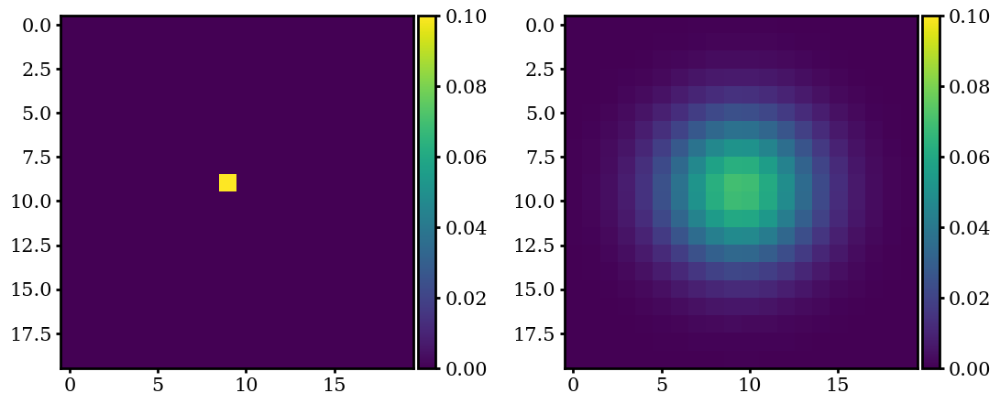

In [16]:
fig, axs = plt.subplots(1,2, figsize=(13,5))

ax = axs[0]
im0 = ax.imshow(diracMap.data, vmin=0, vmax=0.1)
colorbar(im0)
ax = axs[1]
im1 = ax.imshow(gaussMap.data, vmin=0, vmax=0.1)
colorbar(im1)

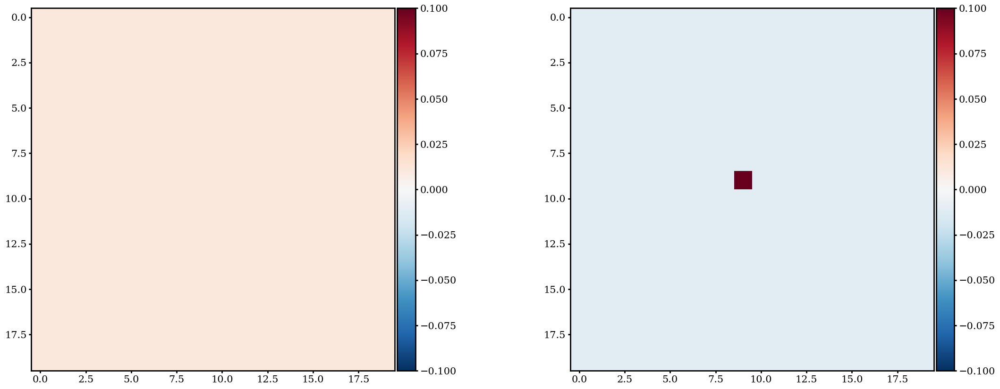

In [17]:
fig, axs = plt.subplots(1,2, figsize=(27,10))
vmin=-0.1
vmax=0.1
ax = axs[0]
im0 = ax.imshow(lopass_map_list[0].data, vmin=vmin, vmax=vmax, cmap='RdBu_r')
colorbar(im0)
ax = axs[1]
im1 = ax.imshow(hipass_map_list[0].data, vmin=vmin, vmax=vmax, cmap='RdBu_r')
colorbar(im1)

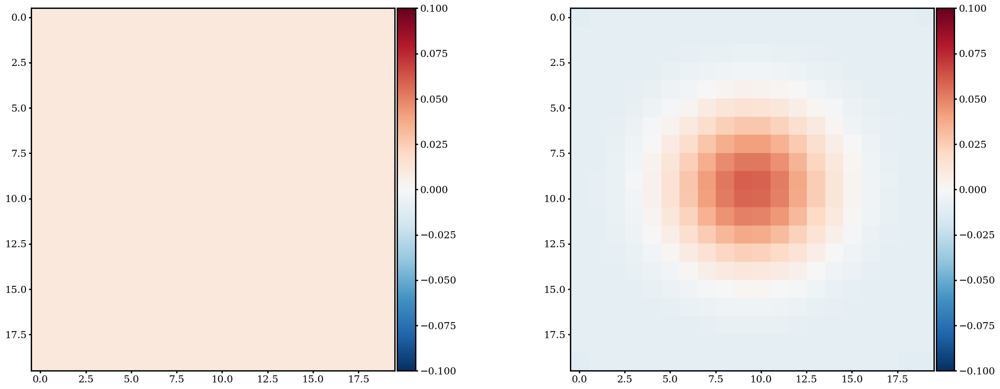

In [18]:
fig, axs = plt.subplots(1,2, figsize=(27,10))
vmin=-0.1
vmax=0.1
ax = axs[0]
im0 = ax.imshow(lopass_map_list[1].data, vmin=vmin, vmax=vmax, cmap='RdBu_r')
colorbar(im0)
ax = axs[1]
im1 = ax.imshow(hipass_map_list[1].data, vmin=vmin, vmax=vmax, cmap='RdBu_r')
colorbar(im1)

/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/flat_map.py:456: RuntimeWarning: invalid value encountered in divide
  sCl /= np.sqrt(Nmodes)


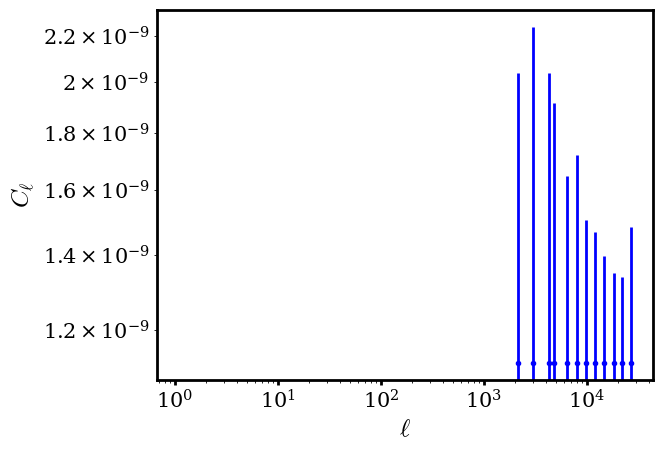

/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/flat_map.py:476: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale('log', nonpositive='clip')


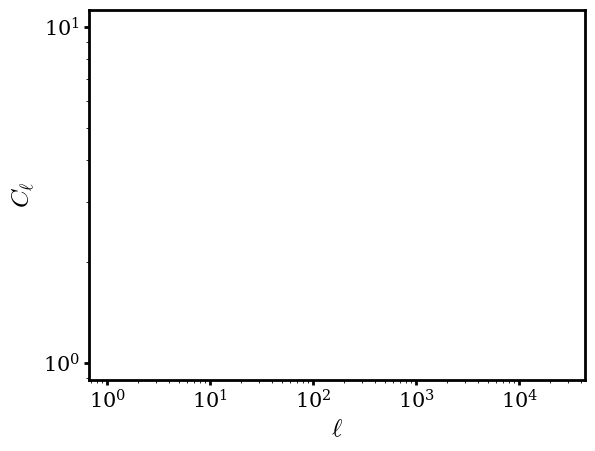

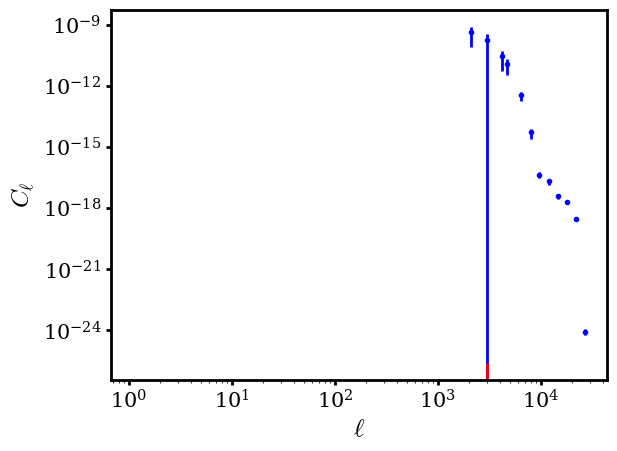

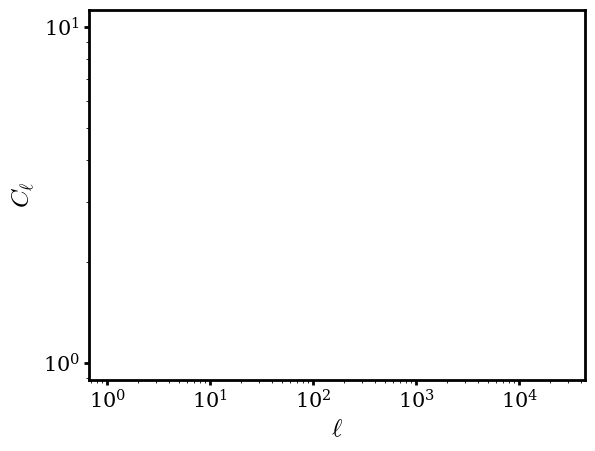

In [19]:
for i in range(2):
    ps1 = hipass_map_list[i].powerSpectrum(plot=True)
    ps2 = lopass_map_list[i].powerSpectrum(plot=True)

- load full catalog from ./output/catalog/single_object/catalog.txt
- Thumbstack: single_object_dirac_ring_tsz_v1
Checking the mMax bins:
number of bins: 20 20
values of mMax: [4.17806035e+12 4.15715432e+12 4.13635290e+12 4.11565557e+12
 4.09506180e+12 4.07457107e+12 4.05418288e+12 4.03389670e+12
 4.01371203e+12 3.99362836e+12 3.97364519e+12 3.95376200e+12
 3.93397831e+12 3.91429361e+12 3.89470740e+12 3.87521920e+12
 3.85582852e+12 3.83653486e+12 3.81733774e+12 3.79823669e+12]
Create overlap flag
- 0
took 1.8894672393798828e-05 min
Out of 1 objects, 1.0 overlap, ie a fraction 1.0
Evaluate all filters on all objects
- analyze object 0
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extrac

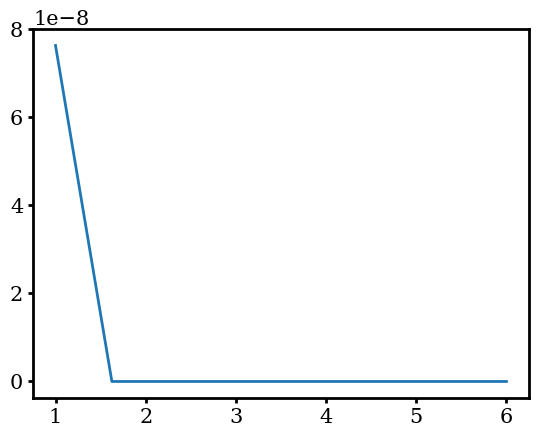

took 0.0746109406153361 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 1.0 in the end
Measure var for each aperture (no hit count)


IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [31]:
# test on 1 object, no filtering
name = 'single_object'
so_cat = Catalog(u, massConversion, name=name, nObj=1)

save=True
bootstrap=False
test=True
stackMap=True
names = ['dirac', 'gauss']
maps = [diracEnmap, gaussEnmap]
for mtype, enmap in zip(names, maps):
    name = so_cat.name + '_%s_ring_tsz_v1'%mtype
    ts_cmass_10x10_rand = ThumbStack(u, so_cat, enmap, boxMask, 
        cmbHit=None, name=name, nameLong=None, save=save, nProc=nProc, filterTypes=['ring'],
        doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

In [ ]:
# test on 1 object, with HPF
name = 'single_object'
so_cat = Catalog(u, massConversion, name=name)

save=True
bootstrap=True
test=False
stackMap=False
names = ['dirac', 'gauss']
for idx in range(2):
    name = so_cat.name + '_%s_hilo_ring_tsz_v1'%names[idx]
    hi_enmap = enmap.enmap(hi_map_list[idx].data, wcs)
    lo_enmap = enmap.enmap(lo_map_list[idx].data, wcs)
    ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, hi_enmap, boxMask, cmbMap2=lo_enmap, 
        cmbHit=None, name=name, nameLong=None, save=save, nProc=nProc, filterTypes=['ring'],
        doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

## The large scale temp of zero doesn't really make sense for these profiles. For positive tau profiles, need a constant negative "background" field. So let's add that and try running again.

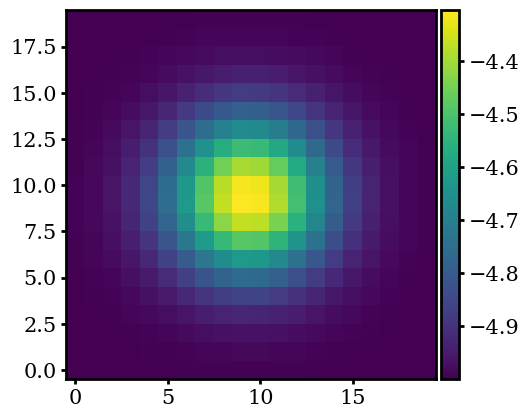

In [12]:
factor = -5. # let's use something not equal to -1 so the TI and sgn estimators are different
im = plt.imshow(gData*10 + factor * np.ones_like(gData), origin='lower')
cbar = colorbar(im)

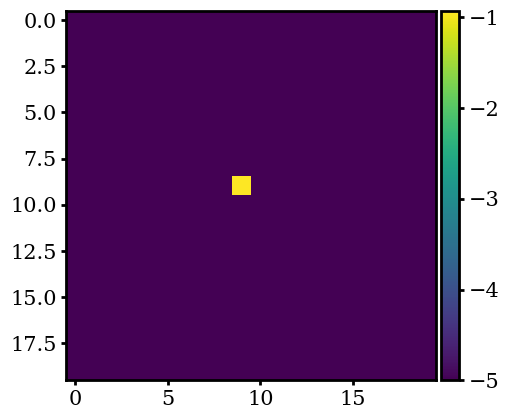

In [13]:
im = plt.imshow(dData + factor * np.ones_like(dData))
cbar = colorbar(im)

In [10]:
offsetDData = dData + factor * np.ones_like(dData)
offsetGData = gData*10 + factor * np.ones_like(gData)
offsetDiracMap = baseMap.copy()
offsetGaussMap = baseMap.copy()
offsetDiracMap.data = offsetDData
offsetGaussMap.data = offsetGData
diracEnmap = enmap.enmap(offsetDiracMap.data, wcs)
gaussEnmap = enmap.enmap(offsetGaussMap.data, wcs)

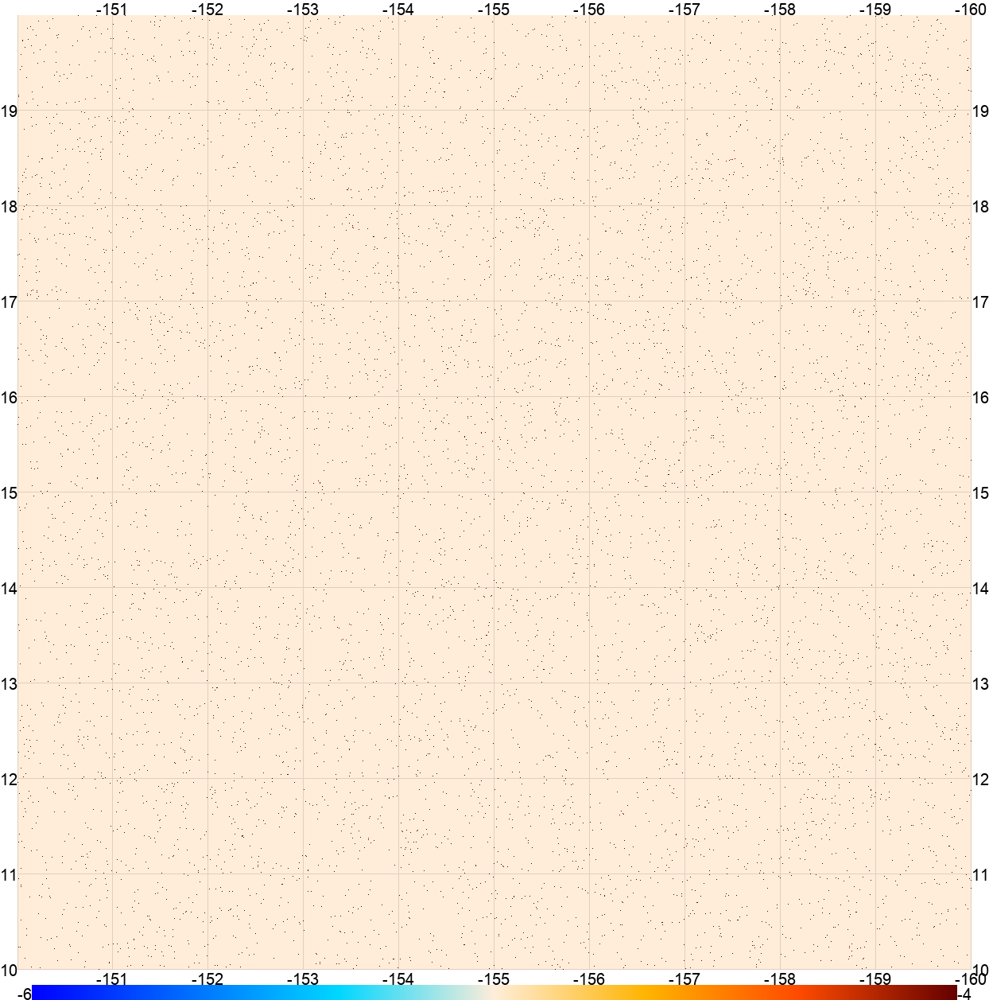

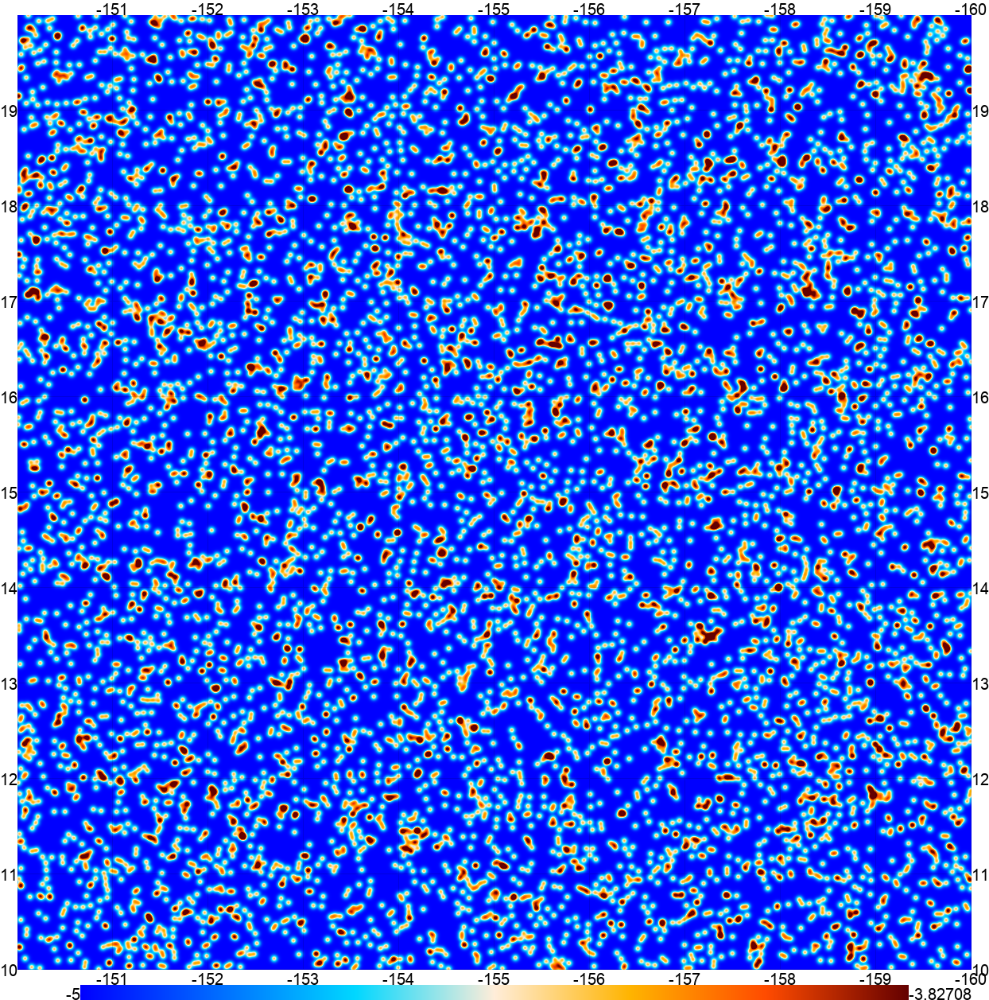

In [11]:
pixell.enplot.pshow(diracEnmap, "-b")
pixell.enplot.pshow(gaussEnmap, "-b")

### Note: needed to turn off outlier rejection (for high deviation sources?) for these maps. This currently has to be hardcoded in catalogMask function (in thumbstack.py)...

- load full catalog from ./output/catalog/cmass_m_10x10_randradec_v2/catalog.txt
- Thumbstack: cmass_m_10x10_randradec_v2_diractau_tauring_tsz_est_10obj_v1
Checking the mMax bins:
number of bins: 20 20
values of mMax: [4.02159276e+12 4.54179873e+12 5.12929501e+12 5.79278582e+12
 6.54210131e+12 7.38834317e+12 8.34404913e+12 9.42337874e+12
 1.06423231e+13 1.20189419e+13 1.35736307e+13 1.53294235e+13
 1.73123337e+13 1.95517398e+13 2.20808203e+13 2.49370454e+13
 2.81627325e+13 3.18056726e+13 3.59198387e+13 4.05661854e+13]
Create overlap flag
- 0
took 0.0001816987991333008 min
Out of 10 objects, 10.0 overlap, ie a fraction 1.0
Evaluate all filters on all objects
- analyze object 0
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pix

 plot the measured profile


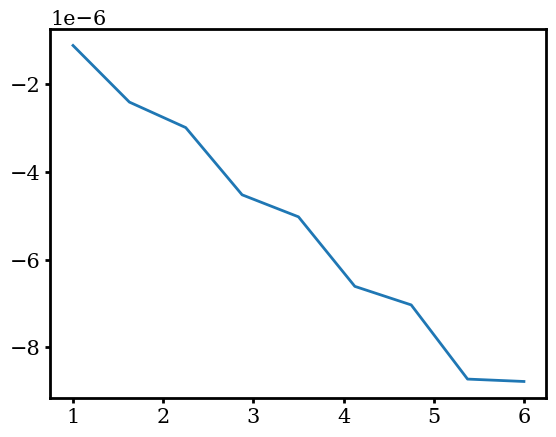

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.3887843975205 dec= 19.63657442610793
Map:
- min, mean, max = -5.000000000000001 -4.976052464646196 -1.3564913936307892
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.973371331849822
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk

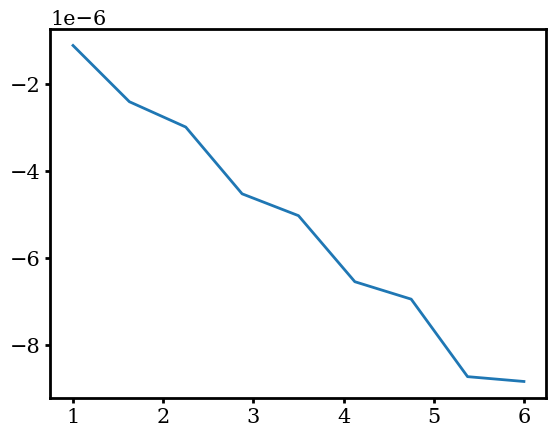

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 208.58597919911384 dec= 19.114872052347895
Map:
- min, mean, max = -5.000000000000001 -4.996650809377416 -2.3813807165775622
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.995562066085687
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- di

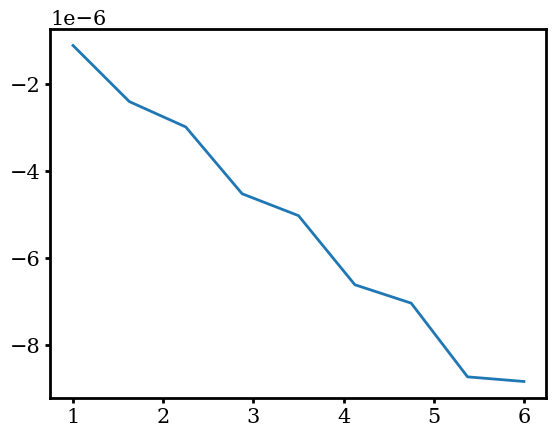

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 206.97368029059365 dec= 19.72905100211363
Map:
- min, mean, max = -5.000000000000001 -4.966787391827836 -0.9267576041726027
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.961805091559148
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- dis

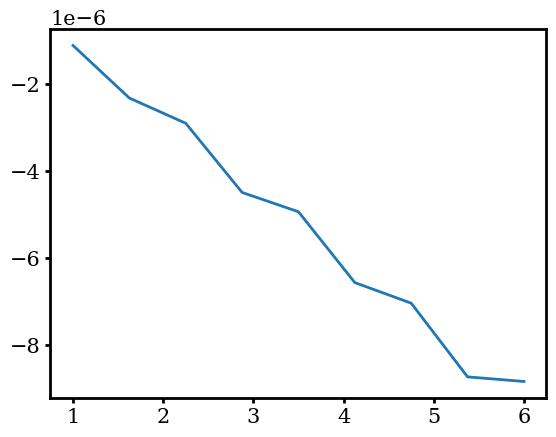

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 200.94177347887648 dec= 19.96919572209523
Map:
- min, mean, max = -5.000000000000001 -2.8815312063403478 0.0
- plot
Mask:
- min, mean, max = 0.0 0.5797101449275363 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -2.9946859060590683
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- di

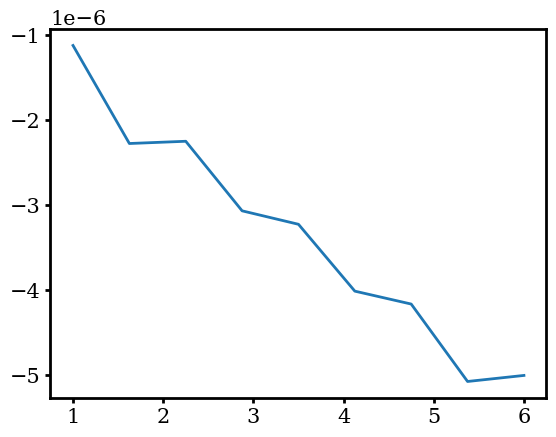

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 209.75622351636756 dec= 16.69800095180972
Map:
- min, mean, max = -5.000000000000001 -4.972686374424821 -1.8947082399505373
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.973300118447256
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- dis

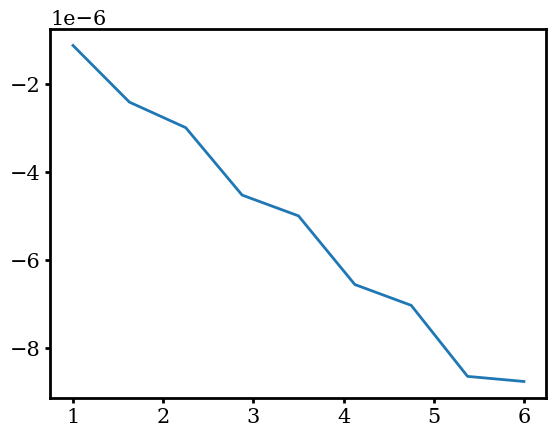

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.61139701990354 dec= 14.516854958057447
Map:
- min, mean, max = -5.000000000000001 -4.983182669285047 -1.0174288739801012
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.977715749642669
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- di

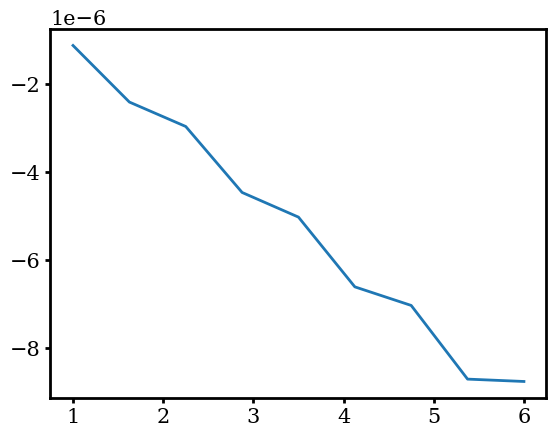

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.86064305276955 dec= 18.507339014963048
Map:
- min, mean, max = -5.000000000000001 -4.979887982800062 -1.4905785749288067
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.986361759591438
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- di

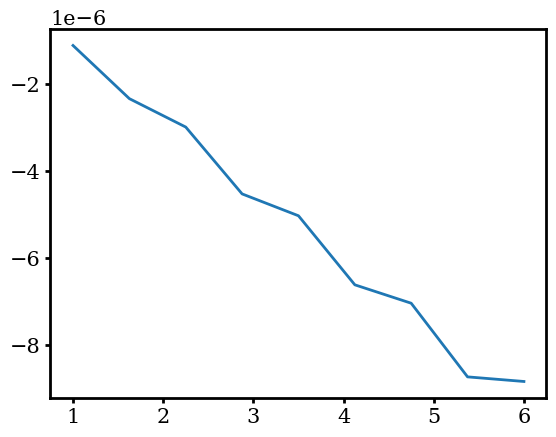

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 201.28113632675547 dec= 10.238048778363385
Map:
- min, mean, max = -5.000000000000001 -4.962093018022667 -1.2637014703104323
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.95548050270431
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- dis

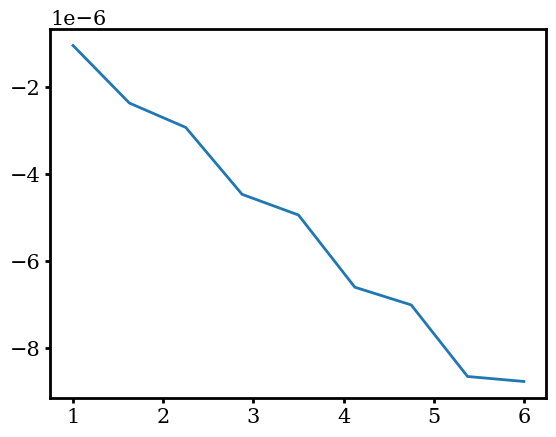

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.50385937895567 dec= 18.344040447135036
Map:
- min, mean, max = -5.000000000000001 -4.969734550933857 -1.716610600753579
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.962049536451306
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- dis

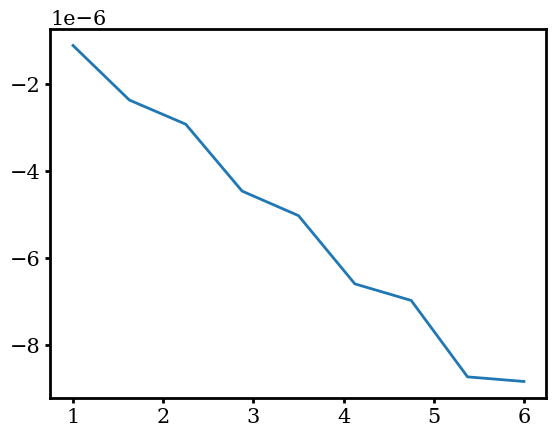

took 0.7435157100359598 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: tauring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
T filtMap: [[-1.11442291e-06 -2.40626608e-06 -2.98800073e-06 -4.52166482e-06
  -5.02407203e-06 -6.61062109e-06 -7.03370084e-06 -8.72601984e-06
  -8.78058893e-06]
 [-1.11459579e-06 -2.40626608e-06 -2.98800073e-06 -4.52166482e-06
  -5.02333472e-06 -6.54047733e-06 -6.94108888e-06 -8.72093

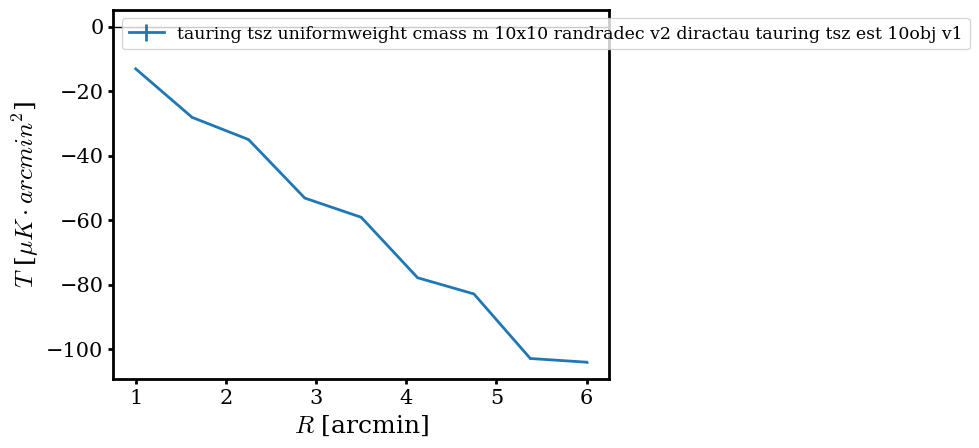

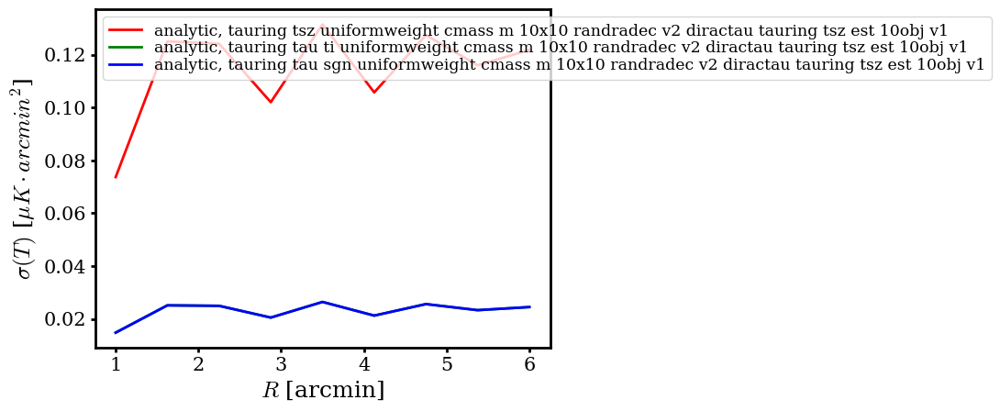

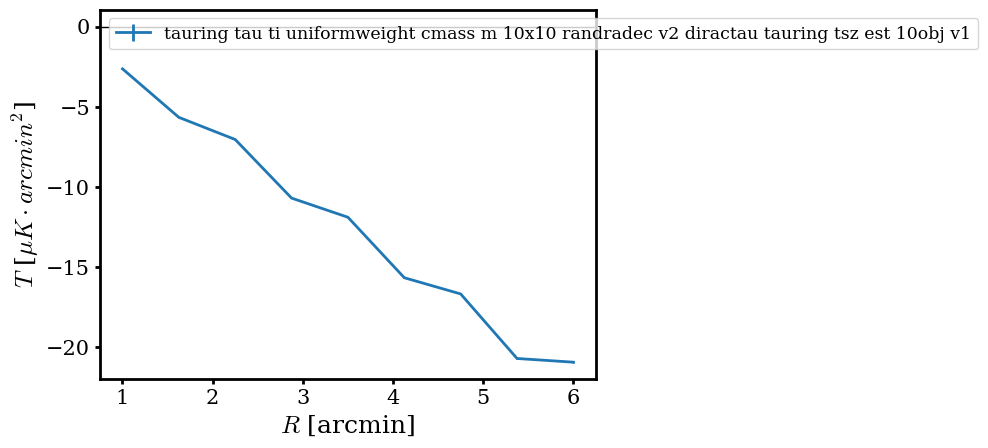

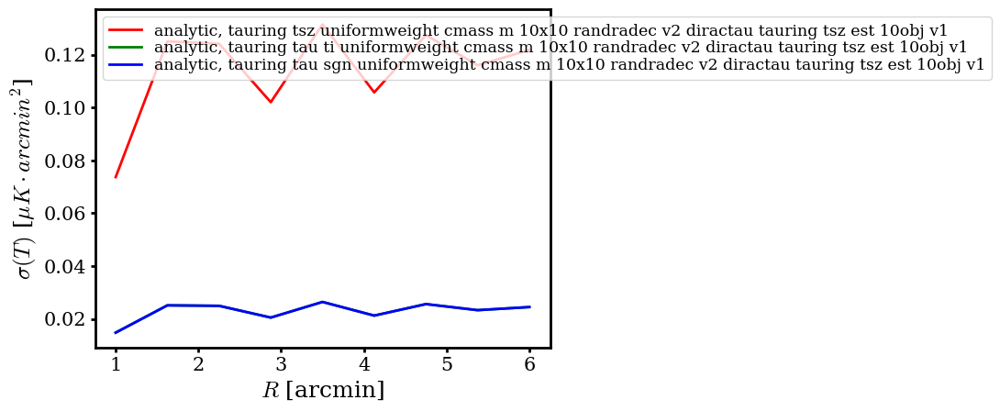

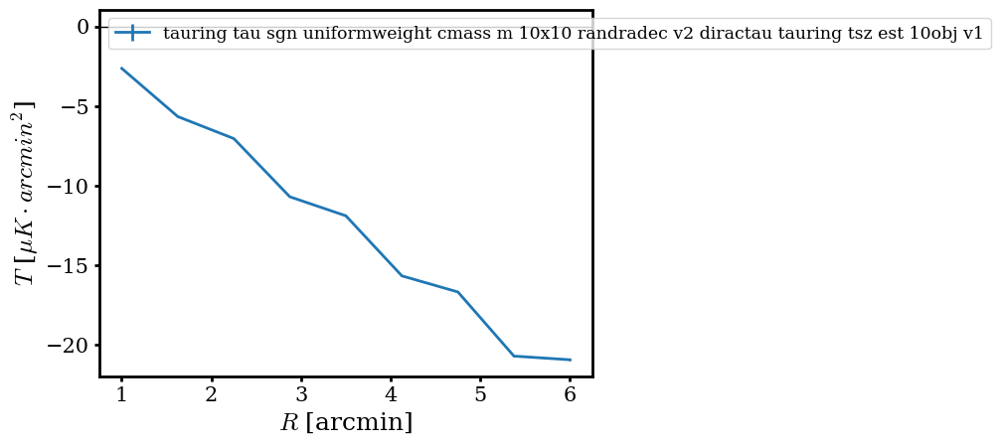

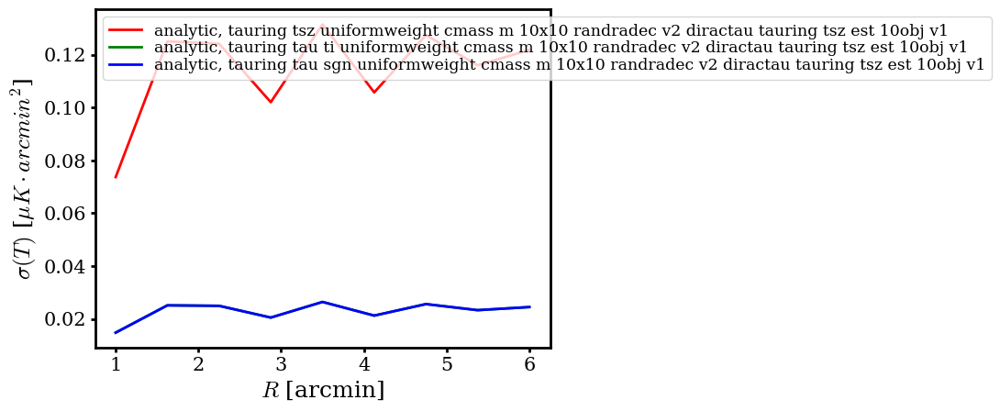

- plot all covariances
- compute all SNR and significances
- compute all stacked maps
compute stacked map: tauring tsz_uniformweight
- Compute stacked profile: tauring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analyze object 0
saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_diractau_tauring_tsz_est_10obj_v1/stackedmap_tauring_tsz_uniformweight.pdf
compute stacked map: tauring tau_ti_uniformweight
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- ana

<Figure size 640x480 with 0 Axes>

In [14]:
# testing on 1 object
name = 'single_object'
cmass_10x10_rand = Catalog(u, massConversion, name=name, nObj=10)

save=True
bootstrap=False
test=True
stackMap=True
name = cmass_10x10_rand.name + '_diractau_tauring_tsz_est_10obj_v1'
ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, diracEnmap, boxMask, cmbMap2=None, cmbHit=None, name=name, 
                            nameLong=None, save=save, nProc=nProc, filterTypes='ring', 
                            doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

- load full catalog from ./output/catalog/cmass_m_10x10_randradec_v2/catalog.txt
- Thumbstack: cmass_m_10x10_randradec_v2_gausstau_tauring_tsz_10obj_v1
Checking the mMax bins:
number of bins: 20 20
values of mMax: [4.02159276e+12 4.54179873e+12 5.12929501e+12 5.79278582e+12
 6.54210131e+12 7.38834317e+12 8.34404913e+12 9.42337874e+12
 1.06423231e+13 1.20189419e+13 1.35736307e+13 1.53294235e+13
 1.73123337e+13 1.95517398e+13 2.20808203e+13 2.49370454e+13
 2.81627325e+13 3.18056726e+13 3.59198387e+13 4.05661854e+13]
Create overlap flag
- 0
took 0.00019412835439046224 min
Out of 10 objects, 10.0 overlap, ie a fraction 1.0
Evaluate all filters on all objects
- analyze object 0
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel


 plot the measured profile


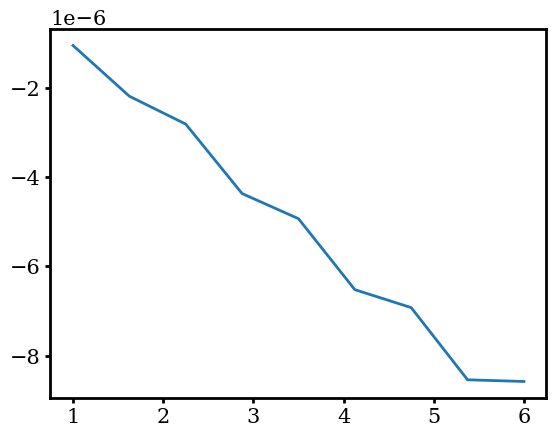

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.3887843975205 dec= 19.63657442610793
Map:
- min, mean, max = -4.999988725232466 -4.739991535967718 -3.581134682818512
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.720546123287989
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk 

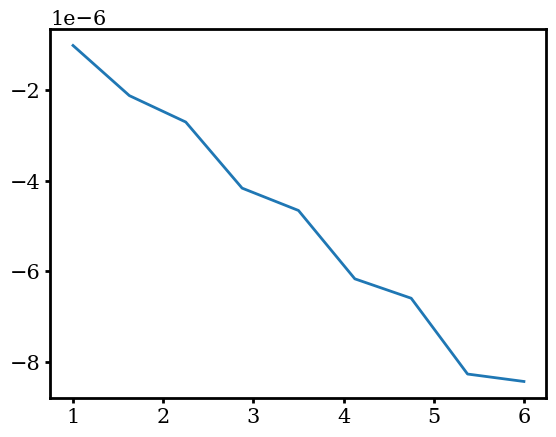

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 208.58597919911384 dec= 19.114872052347895
Map:
- min, mean, max = -5.000000000000001 -4.955127455174448 -4.306662612369642
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.948542078472342
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- dis

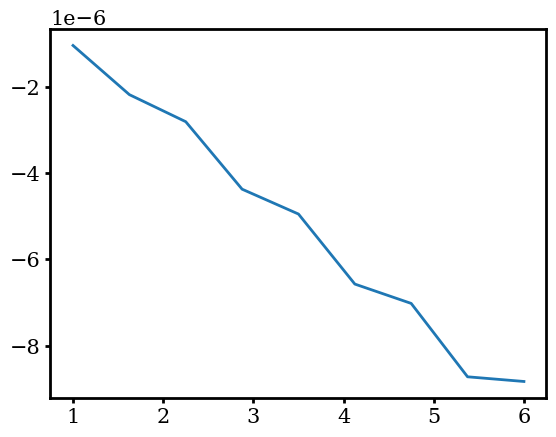

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 206.97368029059365 dec= 19.72905100211363
Map:
- min, mean, max = -4.999943737812214 -4.707504621616711 -3.0038246403878235
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.6721972539532715
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- di

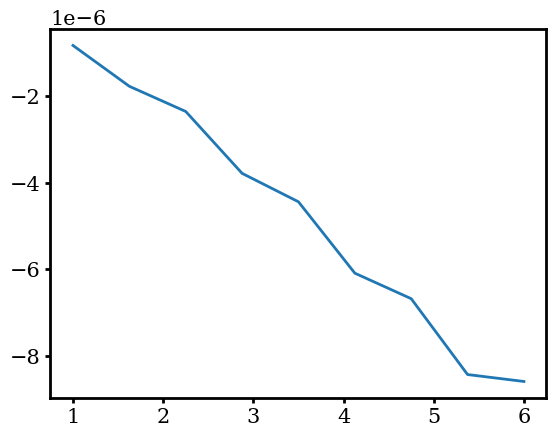

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 200.94177347887648 dec= 19.96919572209523
Map:
- min, mean, max = -4.9986463788111415 -2.75087016593653 0.0
- plot
Mask:
- min, mean, max = 0.0 0.5797101449275363 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -2.856419281799133
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk

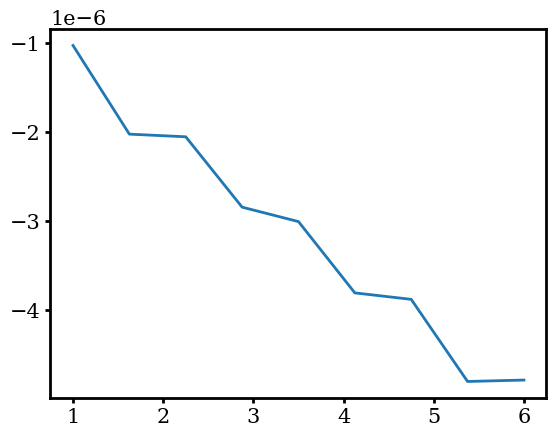

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 209.75622351636756 dec= 16.69800095180972
Map:
- min, mean, max = -4.999999710718806 -4.746484808315253 -3.353242810111377
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.7181590137627065
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- dis

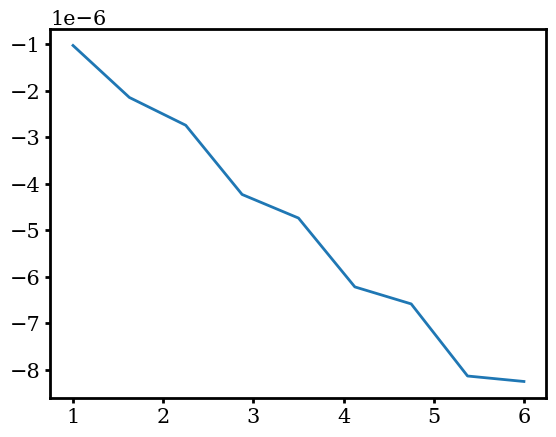

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.61139701990354 dec= 14.516854958057447
Map:
- min, mean, max = -4.99985004871199 -4.82148823663224 -3.919069605357851
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.796514647443455
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk 

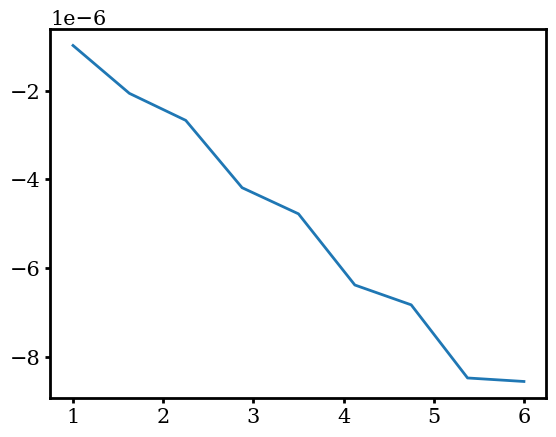

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.86064305276955 dec= 18.507339014963048
Map:
- min, mean, max = -5.0 -4.8067960349590955 -3.6022300461541654
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.842995774803797
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.28

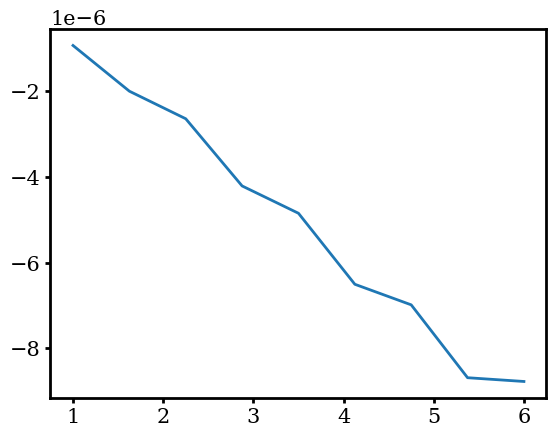

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 201.28113632675547 dec= 10.238048778363385
Map:
- min, mean, max = -4.999957918985516 -4.616064865459092 -3.298521512096077
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.559869555561674
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- dis

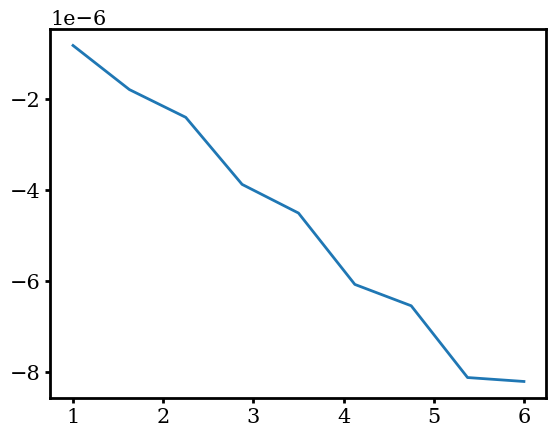

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.50385937895567 dec= 18.344040447135036
Map:
- min, mean, max = -4.999994141606258 -4.697592066800996 -3.532567668923272
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.676183739486137
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- dis

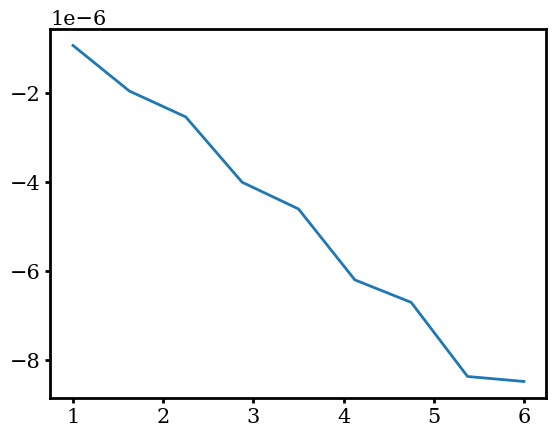

took 0.79798557360967 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: tauring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
T filtMap: [[-1.04023972e-06 -2.17935927e-06 -2.80509223e-06 -4.36398438e-06
  -4.92777246e-06 -6.52088819e-06 -6.92383849e-06 -8.54388480e-06
  -8.58169887e-06]
 [-1.02507757e-06 -2.12952501e-06 -2.71086814e-06 -4.16640674e-06
  -4.65849568e-06 -6.16384739e-06 -6.59109840e-06 -8.2602433

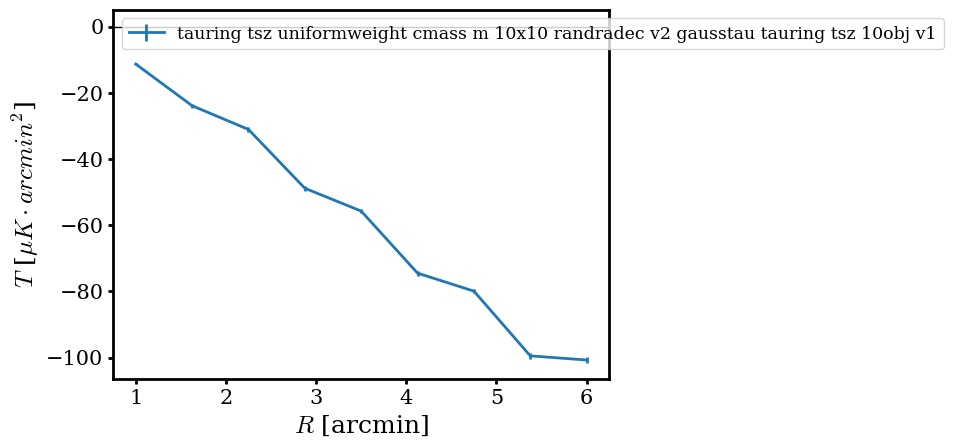

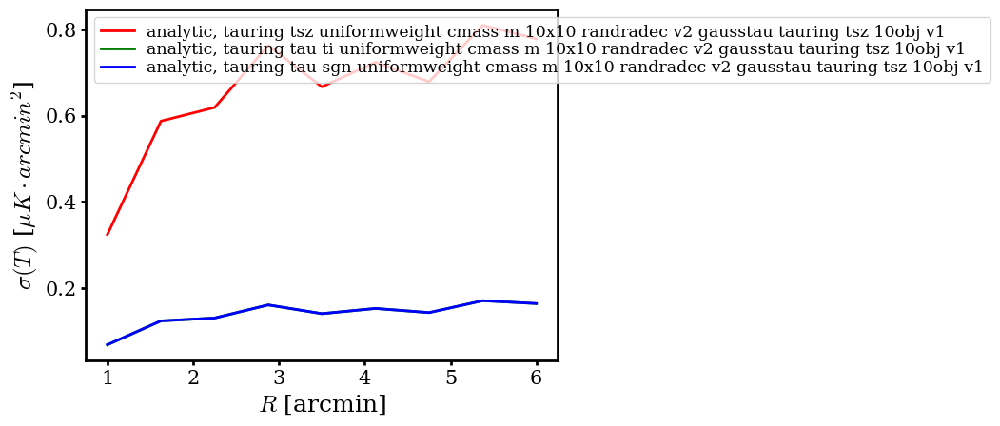

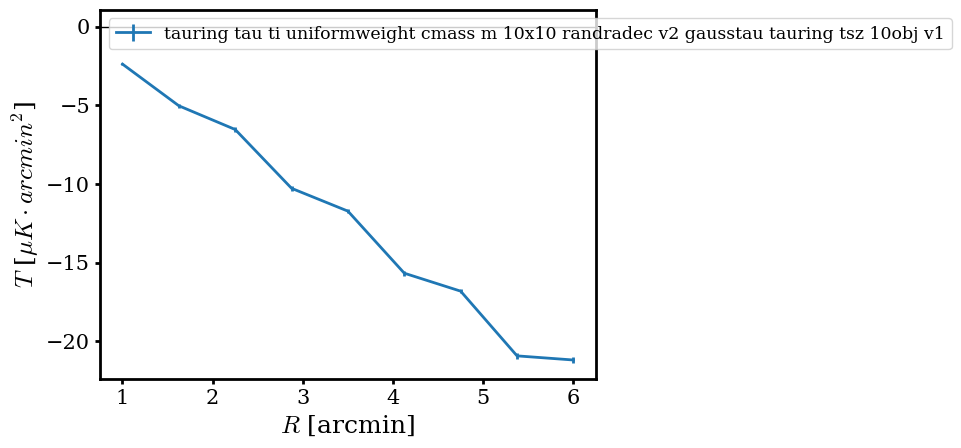

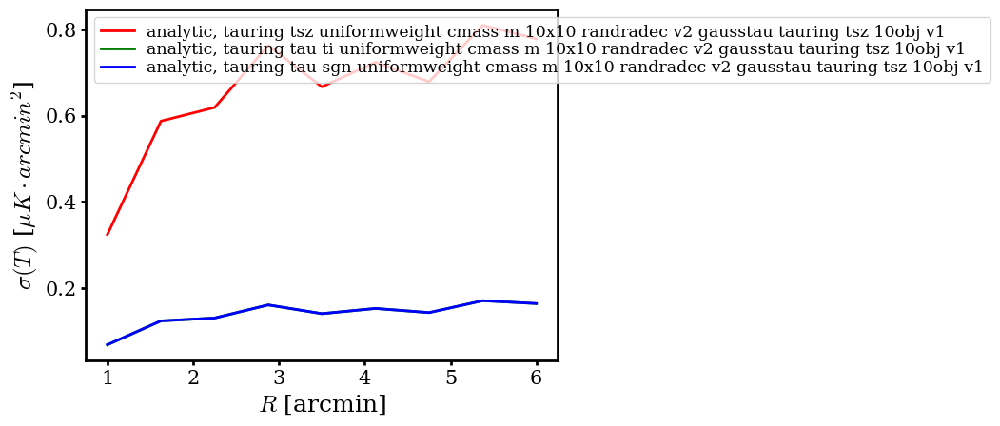

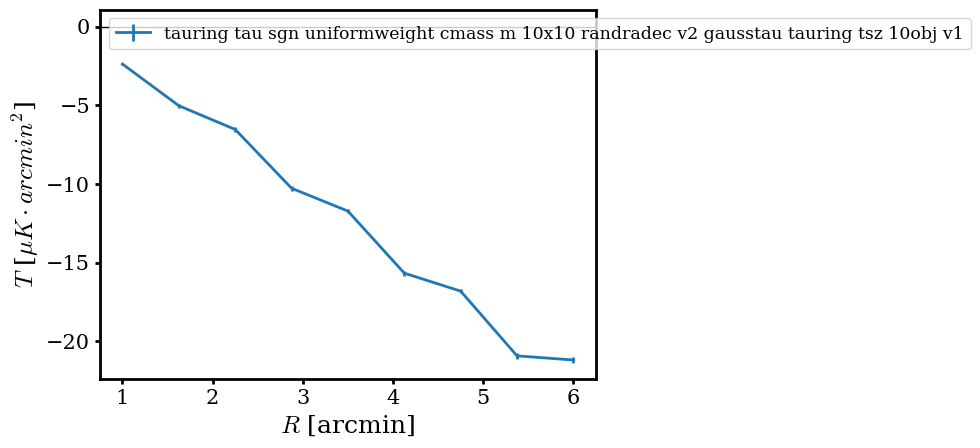

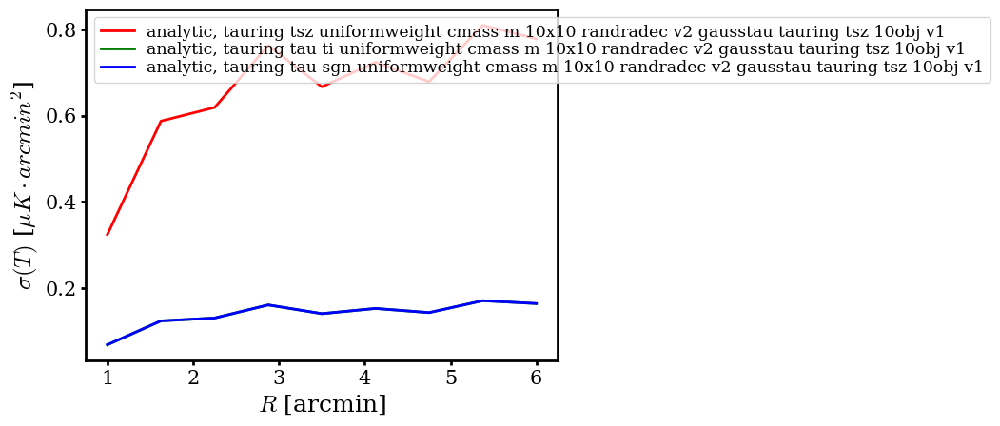

- plot all covariances
- compute all SNR and significances
- compute all stacked maps
compute stacked map: tauring tsz_uniformweight
- Compute stacked profile: tauring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analyze object 0
saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_gausstau_tauring_tsz_10obj_v1/stackedmap_tauring_tsz_uniformweight.pdf
compute stacked map: tauring tau_ti_uniformweight
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analyze

<Figure size 640x480 with 0 Axes>

In [18]:
# testing on 10 objects
cmass_10x10_rand = Catalog(u, massConversion, name="cmass_m_10x10_randradec_v2", nObj=10)

save=True
bootstrap=False
test=True
stackMap=True
name = cmass_10x10_rand.name + '_gausstau_tauring_tsz_10obj_v1'
ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, gaussEnmap, boxMask, cmbMap2=None, cmbHit=None, name=name, 
                            nameLong=None, save=save, nProc=nProc, filterTypes='tauring', 
                            doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

### Testing on a constant map

In [19]:
factor = -5
constData = factor * np.ones_like(dData)
constMap = baseMap.copy()
constMap.data = constData.data
constEnmap = enmap.enmap(constMap.data, wcs)

- load full catalog from ./output/catalog/cmass_m_10x10_randradec_v2/catalog.txt
- Thumbstack: cmass_m_10x10_randradec_v2_const_tauring_10obj_v2
Checking the mMax bins:
number of bins: 20 20
values of mMax: [4.02159276e+12 4.54179873e+12 5.12929501e+12 5.79278582e+12
 6.54210131e+12 7.38834317e+12 8.34404913e+12 9.42337874e+12
 1.06423231e+13 1.20189419e+13 1.35736307e+13 1.53294235e+13
 1.73123337e+13 1.95517398e+13 2.20808203e+13 2.49370454e+13
 2.81627325e+13 3.18056726e+13 3.59198387e+13 4.05661854e+13]
Create overlap flag
- 0
took 0.00025286277135213214 min
Out of 10 objects, 10.0 overlap, ie a fraction 1.0
Evaluate all filters on all objects
- analyze object 0
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(reques

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: -8.831789775066028e-06
- filter on map [map unit * arcmin^2]: -104.37499999999999
 filter on map / area [map unit]: -4.999999999999999
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


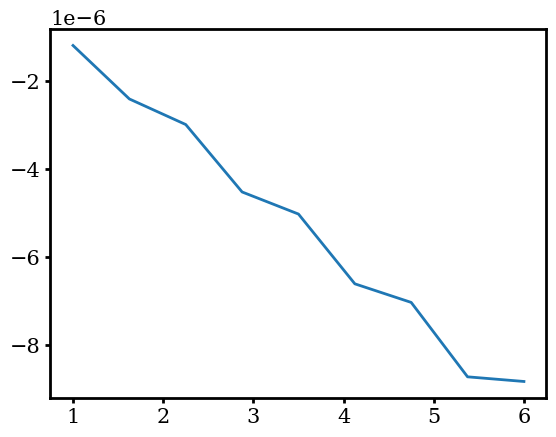

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.3887843975205 dec= 19.63657442610793
Map:
- min, mean, max = -5.000000000000001 -5.0 -4.999999999999999
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring area: 2.3798235920836608e-07

 plot the measured profile


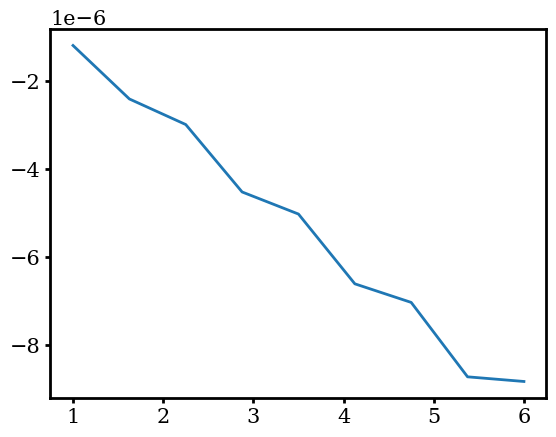

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 208.58597919911384 dec= 19.114872052347895
Map:
- min, mean, max = -5.000000000000001 -5.0 -4.999999999999999
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring area: 2.3798235920836608e-

 plot the measured profile


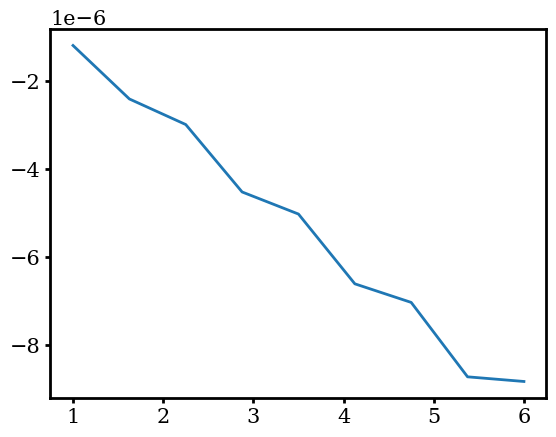

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 206.97368029059365 dec= 19.72905100211363
Map:
- min, mean, max = -5.000000000000001 -5.0 -4.999999999999999
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring area: 2.3798235920836608e-0

 plot the measured profile


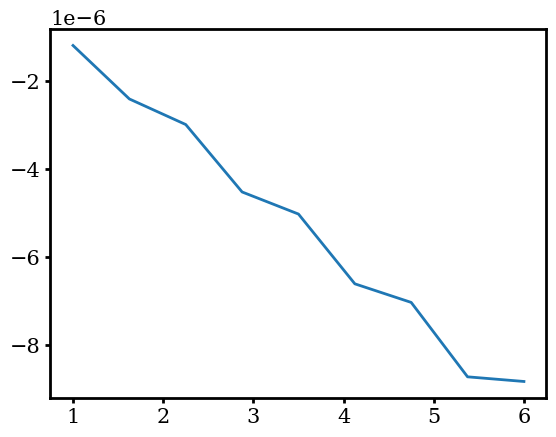

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 200.94177347887648 dec= 19.96919572209523
Map:
- min, mean, max = -5.000000000000001 -2.898550724637681 0.0
- plot
Mask:
- min, mean, max = 0.0 0.5797101449275363 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -3.012802671861954
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -3.012802671861954
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: -5.076956996445142e-06
- filter on map [map unit * arcmin^2]: -59.99999999999999
 filter on map / area [map unit]: -2.8742514970059876
- filter on mask: 636.0
- filter on inverse hit (or Tlarge): -3.012802671861954
- plot the filter
 plot the measured profile


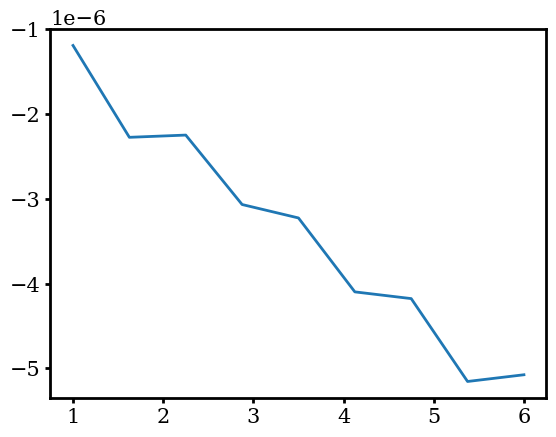

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 209.75622351636756 dec= 16.69800095180972
Map:
- min, mean, max = -5.000000000000001 -5.0 -4.999999999999999
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring area: 2.3798235920836608e-0

 plot the measured profile


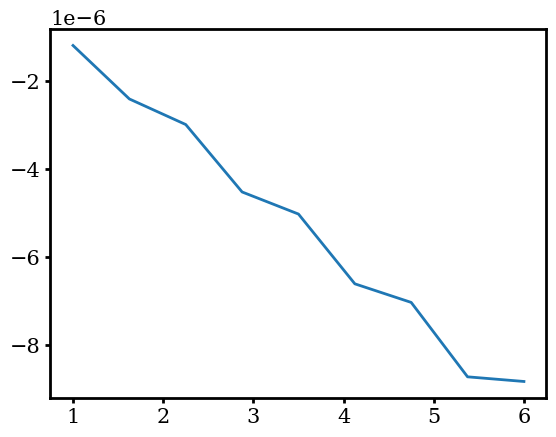

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.61139701990354 dec= 14.516854958057447
Map:
- min, mean, max = -5.000000000000001 -5.0 -4.999999999999999
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring area: 2.3798235920836608e-

 plot the measured profile


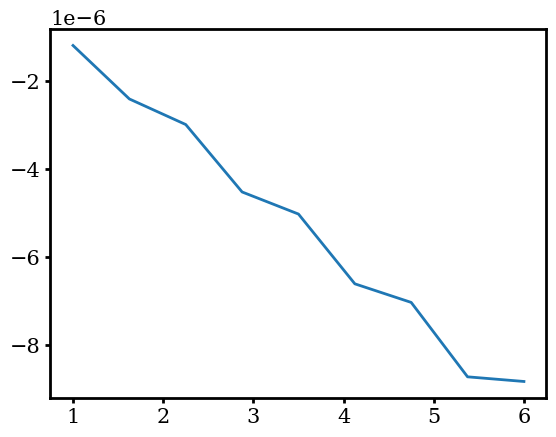

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.86064305276955 dec= 18.507339014963048
Map:
- min, mean, max = -5.000000000000001 -5.0 -4.999999999999999
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring area: 2.3798235920836608e-

 plot the measured profile


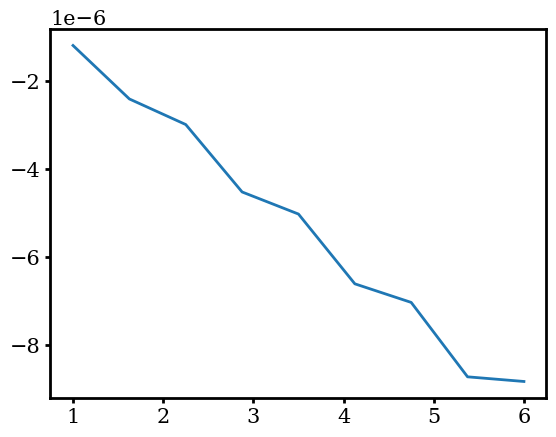

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 201.28113632675547 dec= 10.238048778363385
Map:
- min, mean, max = -5.000000000000001 -5.0 -4.999999999999999
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring area: 2.3798235920836608e-

 plot the measured profile


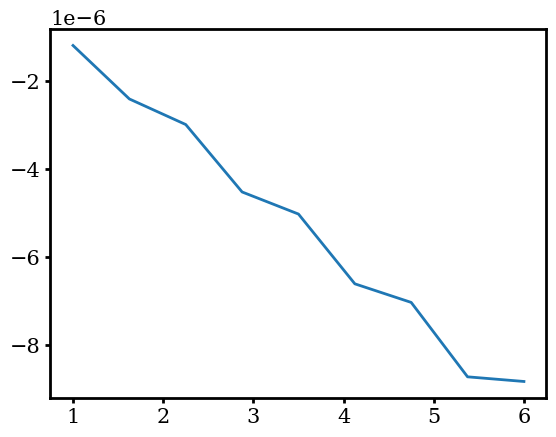

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.50385937895567 dec= 18.344040447135036
Map:
- min, mean, max = -5.000000000000001 -5.0 -4.999999999999999
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring area: 2.3798235920836608e-

 plot the measured profile


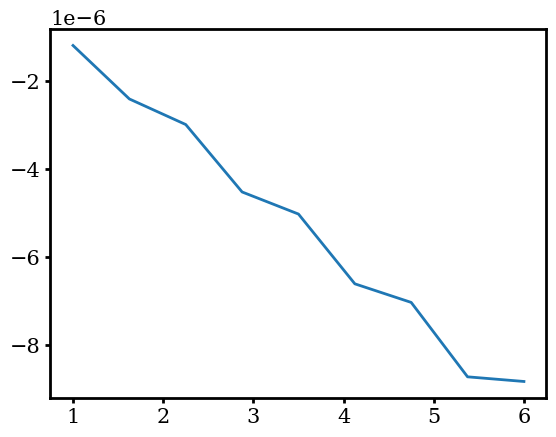

took 0.7926899035771687 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
T filtMap: [[-1.18991180e-06 -2.40626608e-06 -2.98800073e-06 -4.52166482e-06
  -5.02407203e-06 -6.61062109e-06 -7.03370084e-06 -8.72601984e-06
  -8.83178978e-06]
 [-1.18991180e-06 -2.40626608e-06 -2.98800073e-06 -4.52166482e-06
  -5.02407203e-06 -6.61062109e-06 -7.03370084e-06 -8.72

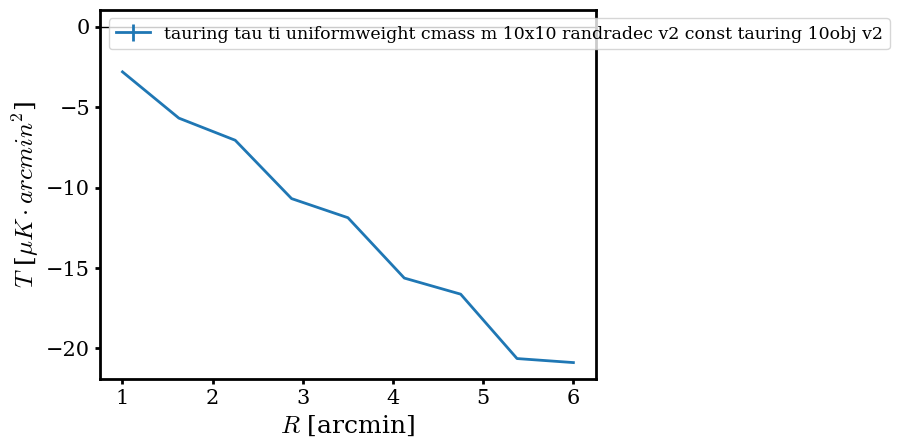

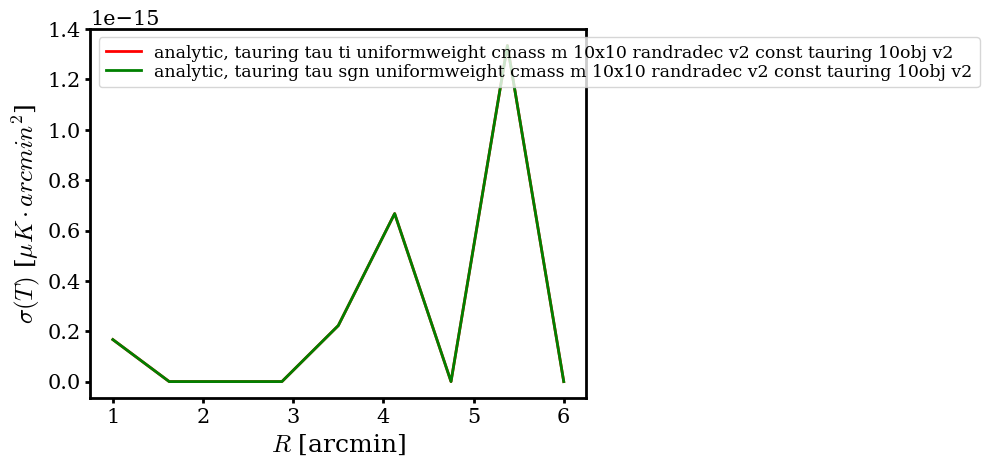

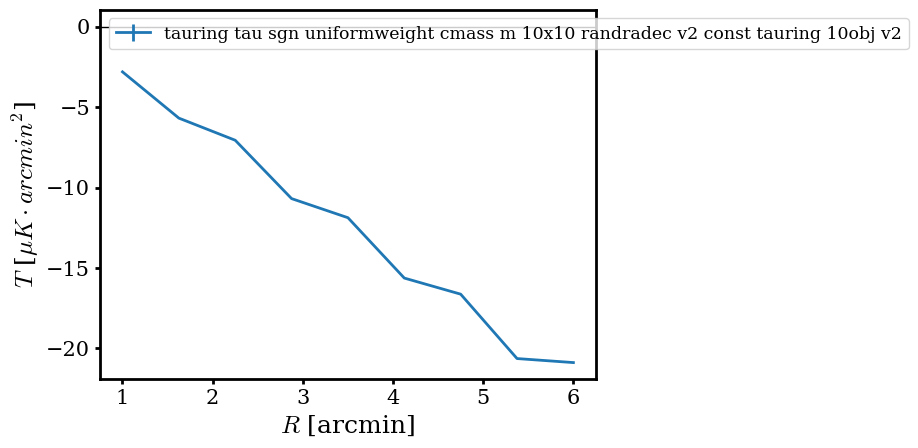

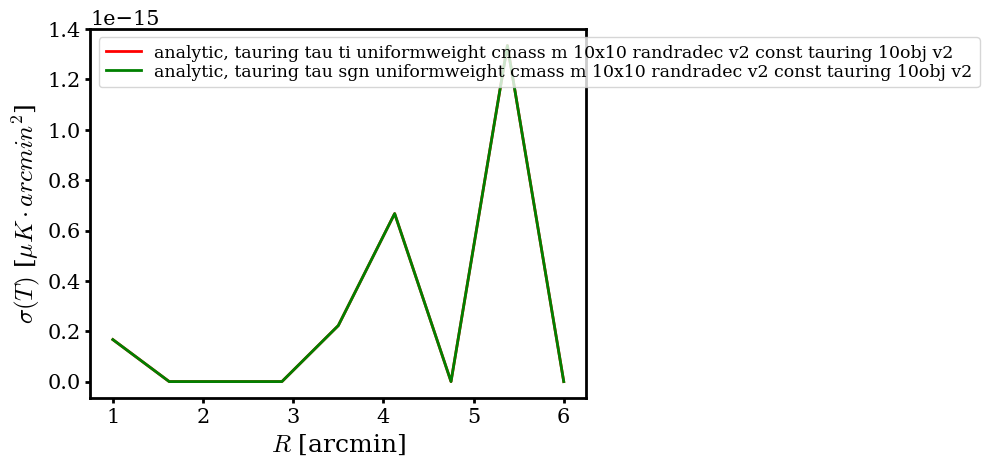

- plot all covariances
- compute all SNR and significances
- compute all stacked maps
compute stacked map: tauring tau_ti_uniformweight
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analyze object 0
saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_const_tauring_10obj_v2/stackedmap_tauring_tau_ti_uniformweight.pdf
compute stacked map: tauring tau_sgn_uniformweight
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- ana

<Figure size 640x480 with 0 Axes>

In [49]:
# testing on 10 objects
name = 'cmass_m_10x10_randradec_v2'
cmass_10x10_rand = Catalog(u, massConversion, name=name, nObj=10)

save=True
bootstrap=False
test=True
stackMap=True
name = cmass_10x10_rand.name + '_const_tauring_10obj_v2'
ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, constEnmap, boxMask, cmbMap2=None, cmbHit=None, name=name, 
                            nameLong=None, save=save, nProc=nProc, filterTypes='tauring', 
                            doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

## Try filtering first, then run tauring

In [20]:
# flat_map doesn't automatically calculate the fourier transform of the data
offsetDiracMap.dataFourier = offsetDiracMap.fourier(offsetDiracMap.data)
offsetGaussMap.dataFourier = offsetGaussMap.fourier(offsetGaussMap.data)
constMap.dataFourier = constMap.fourier(constMap.data)

/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/flat_map.py:456: RuntimeWarning: invalid value encountered in divide
  sCl /= np.sqrt(Nmodes)


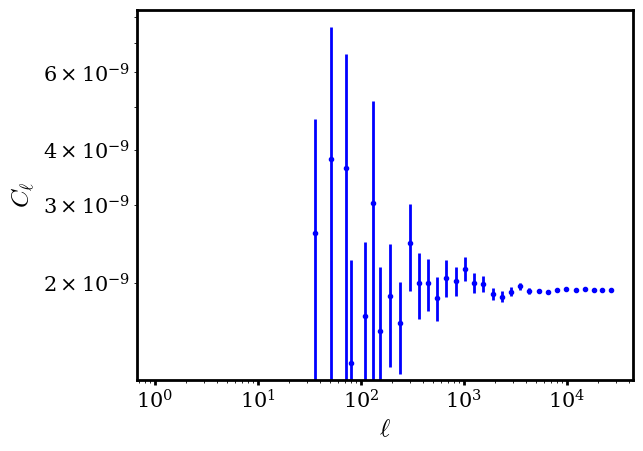

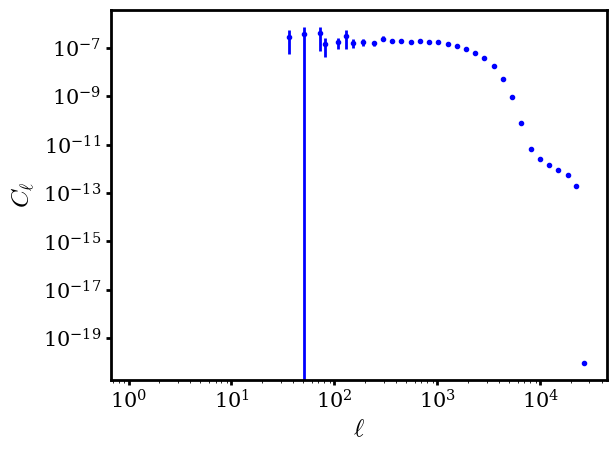

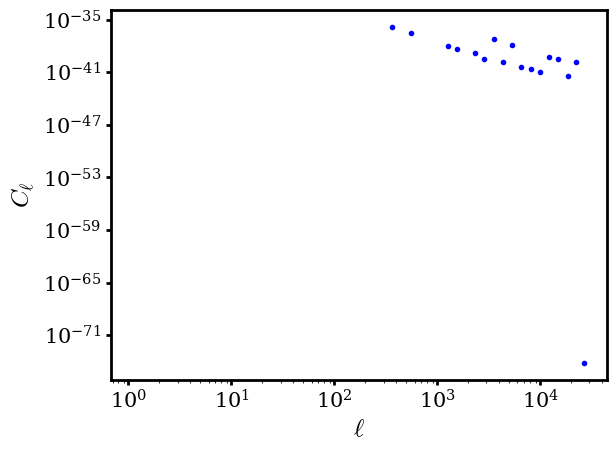

In [21]:
odm_ps = offsetDiracMap.powerSpectrum(plot=True)
ogm_ps = offsetGaussMap.powerSpectrum(plot=True)
cm_ps = constMap.powerSpectrum(plot=True)

In [22]:
from scipy.special import erf

def high_pass(ell):
    loc = 1500
    half_width = 50
    return erf(2/np.sqrt(2)/half_width*(ell-loc))/2 + 0.5

def low_pass(ell):
    loc = 1000
    half_width = 50
    return -1 * erf(2/np.sqrt(2)/half_width*(ell-loc))/2 + 0.5

In [23]:
def make_filtered_map(flatmap_list, filt=high_pass):
    filter_map_list = []
    for flatmap in flatmap_list:
        map_filt_fourier = flatmap.filterFourierIsotropic(fW=filt)
        map_filt_data = flatmap.inverseFourier(map_filt_fourier)
        filt_flat_map = baseMap.copy()
        filt_flat_map.data = map_filt_data
        filt_flat_map.dataFourier = map_filt_fourier
        filter_map_list.append(filt_flat_map)
    
    return filter_map_list

In [24]:
hi_map_list = make_filtered_map([offsetDiracMap, offsetGaussMap, constMap], filt=high_pass)
lo_map_list = make_filtered_map([offsetDiracMap, offsetGaussMap, constMap], filt=low_pass)

In [25]:
hi_odm, hi_ogm, hi_cm = hi_map_list
lo_odm, lo_ogm, lo_cm = lo_map_list

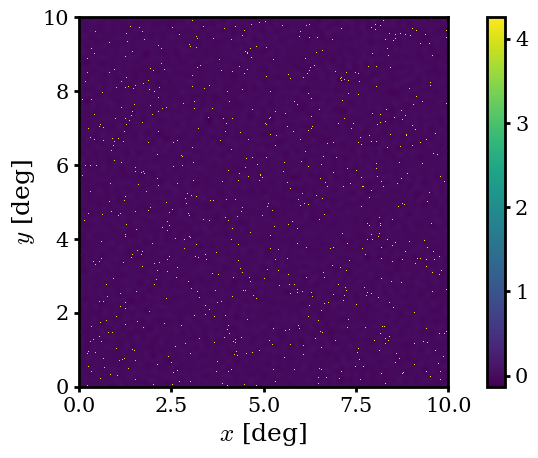

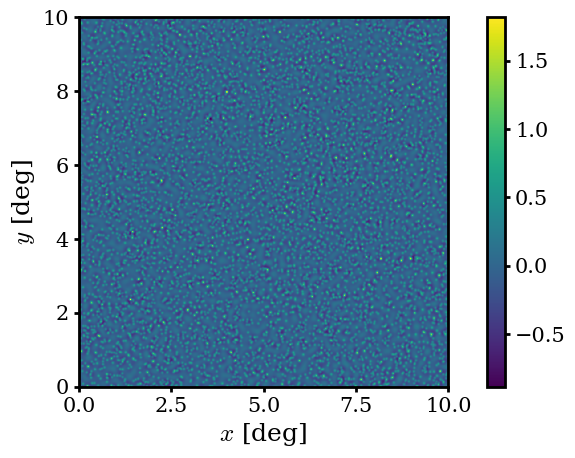

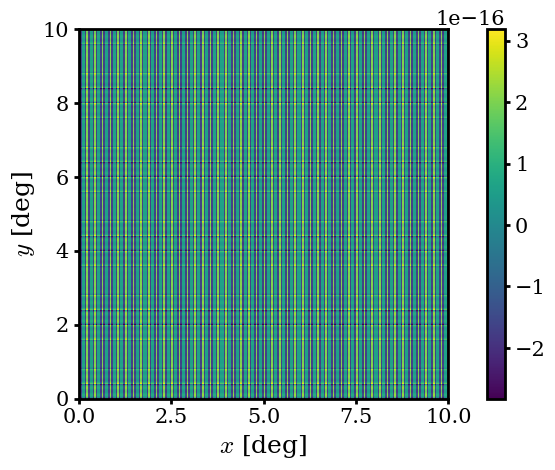

In [26]:
for fm in hi_map_list:
    fm.plot()

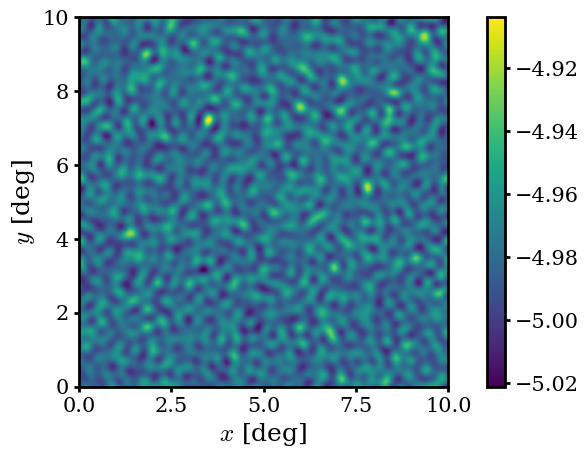

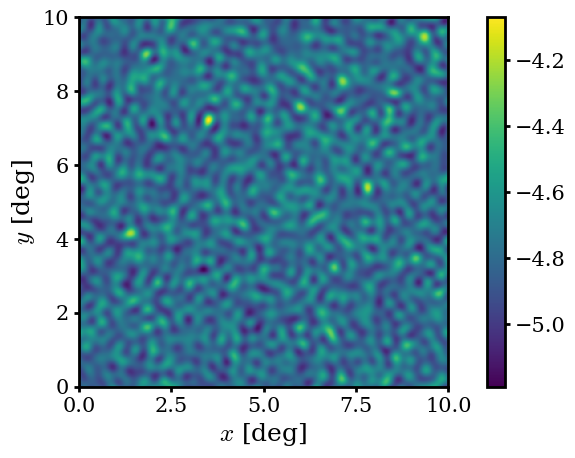

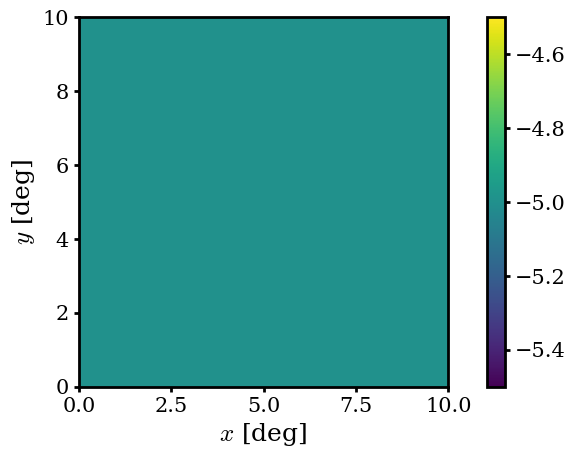

In [27]:
for fm in lo_map_list:
    fm.plot()

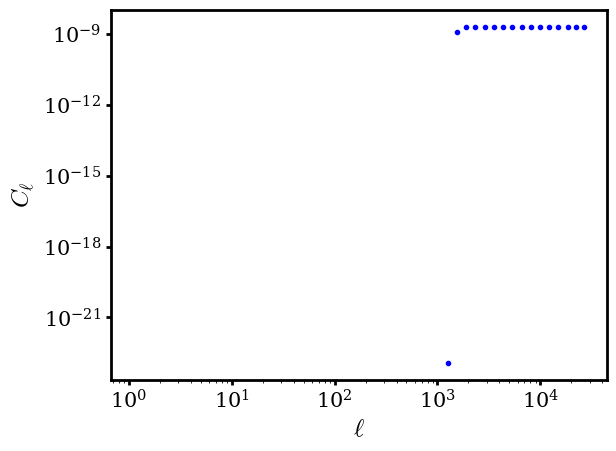

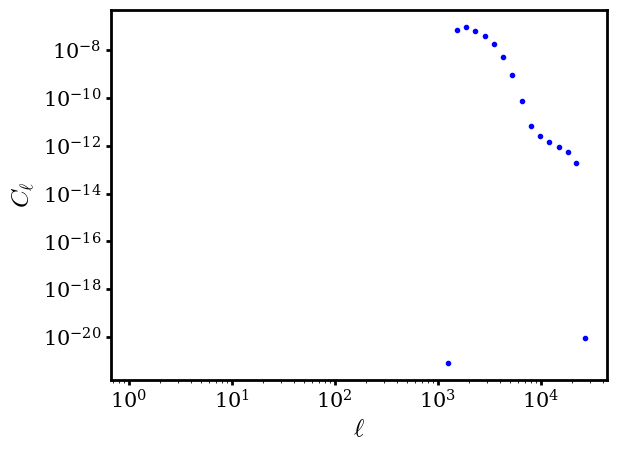

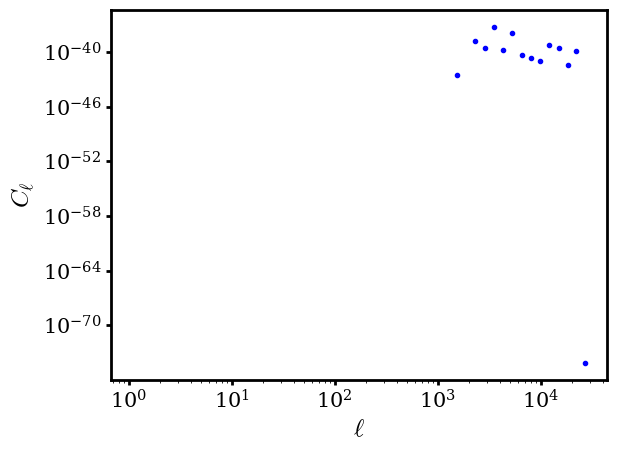

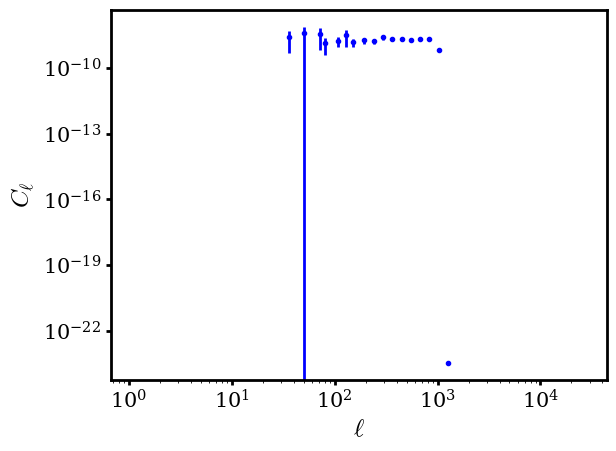

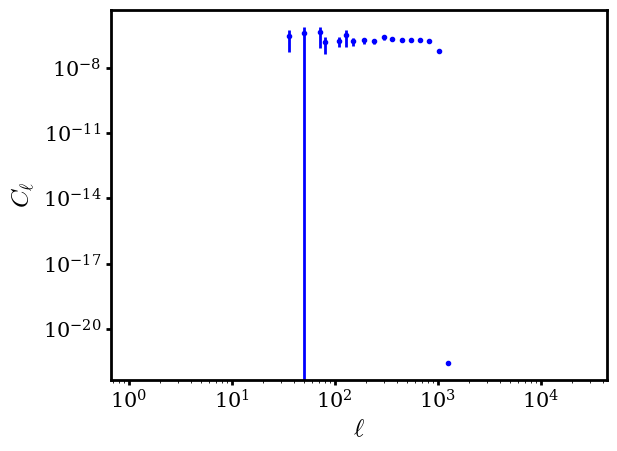

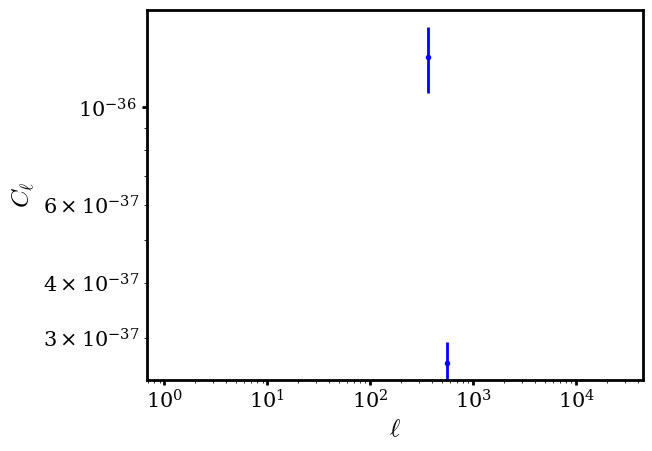

In [28]:
for fm in hi_map_list:
    fm.powerSpectrum(plot=True)
for fm in lo_map_list:
    fm.powerSpectrum(plot=True)

- load full catalog from ./output/catalog/cmass_m_10x10_randradec_v2/catalog.txt
- Thumbstack: cmass_m_10x10_randradec_v2_dirac_hilo_ring+tauring_tsz_10obj_v1
Checking the mMax bins:
number of bins: 20 20
values of mMax: [4.02159276e+12 4.54179873e+12 5.12929501e+12 5.79278582e+12
 6.54210131e+12 7.38834317e+12 8.34404913e+12 9.42337874e+12
 1.06423231e+13 1.20189419e+13 1.35736307e+13 1.53294235e+13
 1.73123337e+13 1.95517398e+13 2.20808203e+13 2.49370454e+13
 2.81627325e+13 3.18056726e+13 3.59198387e+13 4.05661854e+13]
Create overlap flag
- 0
took 0.00019568204879760742 min
Out of 10 objects, 10.0 overlap, ie a fraction 1.0
Evaluate all filters on all objects
- analyze object 0
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 137.0
No. pixels in ring= 113.0
T_large= -4.978186194108249
AP filter with disk radius = 1.6250000000000002 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4648
+ nb of pixels where filter>0: 113
+ nb of pixels where filter<0: 0
- disk area: 7.245240713676923e-07 sr, ie 8.562500000000002arcmin^2
  (from r0, expect 7.019542983446222e-07 sr, ie 8.295768100885551arcmin^2)
- disk-ring filter sums over pixels to 113.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 7.245240713676923e-07)
- filter on map: -8.102927323299767e-09
- filter on mask: 0.0
- filter on inverse hit: -4.978186194108249
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 

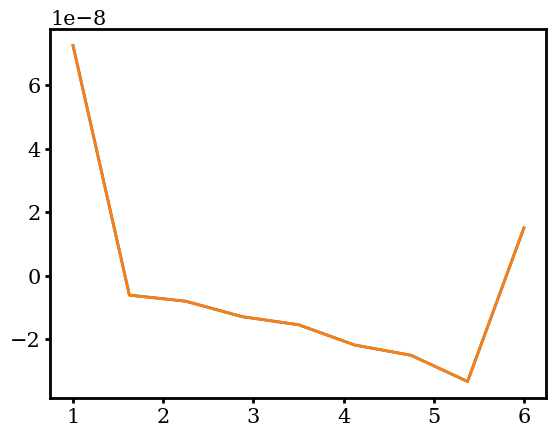

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.3887843975205 dec= 19.63657442610793
Map:
- min, mean, max = -0.06041101403638358 0.0008922121521197471 3.598696983932016
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)
- filter on unit

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -4.980088741680324
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: -2.5419814358230852e-08
- filter on mask: 0.0
- filter on inverse hit: -4.980088741680324
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0
T_

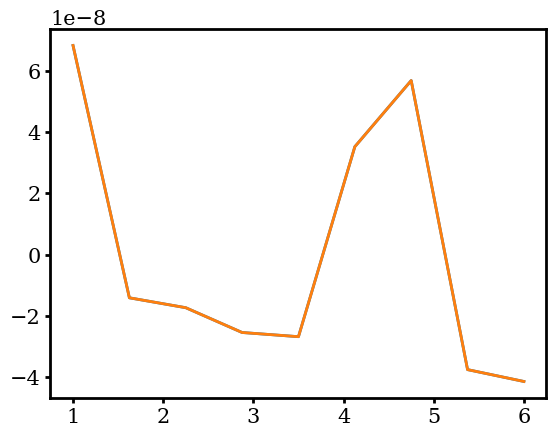

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 208.58597919911384 dec= 19.114872052347895
Map:
- min, mean, max = -0.03819119905461065 -0.00576995136731008 2.6176219952789643
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)
- filter on un

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -4.99322302662231
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: -1.366970962261513e-09
- filter on mask: 0.0
- filter on inverse hit: -4.99322302662231
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0
T_lar

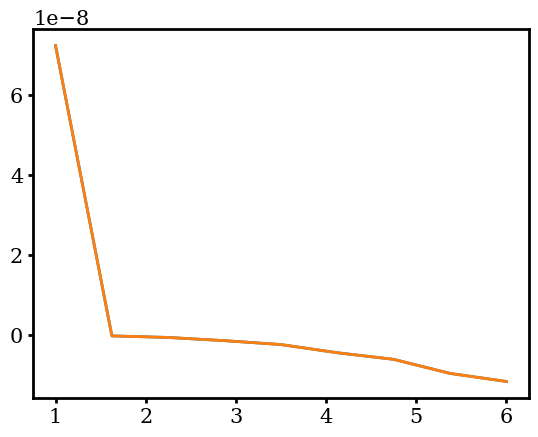

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 206.97368029059365 dec= 19.72905100211363
Map:
- min, mean, max = -0.07420741728681668 0.0010831887050551448 4.046412391807794
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)
- filter on uni

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -4.966799232089827
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: -2.285654379534596e-08
- filter on mask: 0.0
- filter on inverse hit: -4.966799232089827
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0
T_l

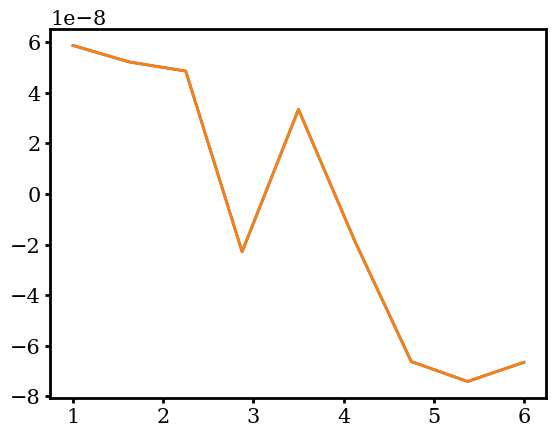

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 200.94177347887648 dec= 19.96919572209523
Map:
- min, mean, max = -0.05263236839966221 0.0018774603571241756 3.3556006201476287
- plot
Mask:
- min, mean, max = 0.0 0.5797101449275363 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -3.0017109475460635
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: -2.7730304574275605e-08
- filter on mask: 88.0
- filter on inverse hit: -3.0017109475460635
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0

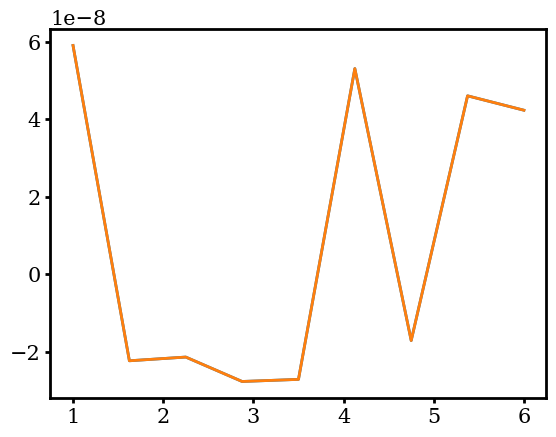

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 209.75622351636756 dec= 16.69800095180972
Map:
- min, mean, max = -0.06380048718007272 0.0008213195464180806 3.0790166468902616
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)
- filter on un

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -4.973483128346135
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: -3.562468159945674e-08
- filter on mask: 0.0
- filter on inverse hit: -4.973483128346135
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0
T_l

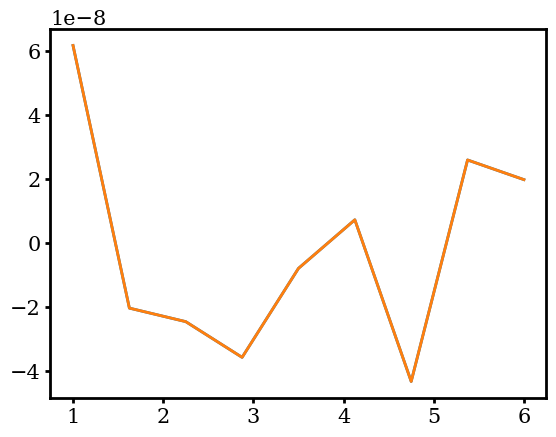

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.61139701990354 dec= 14.516854958057447
Map:
- min, mean, max = -0.048102820772515334 -0.003083434762524729 3.9607516667215488
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)
- filter on 

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -4.978833162052782
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: 3.010990921955189e-08
- filter on mask: 0.0
- filter on inverse hit: -4.978833162052782
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0
T_la

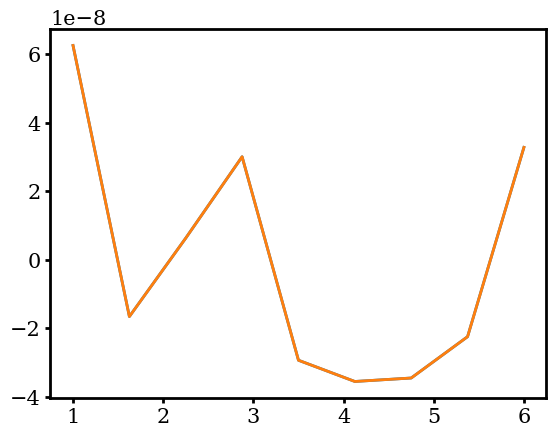

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.86064305276955 dec= 18.507339014963048
Map:
- min, mean, max = -0.05271847820480538 0.0014498741809150346 3.46194389559289
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)
- filter on uni

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -4.980765707372918
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: -2.1836369905209833e-08
- filter on mask: 0.0
- filter on inverse hit: -4.980765707372918
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0
T_

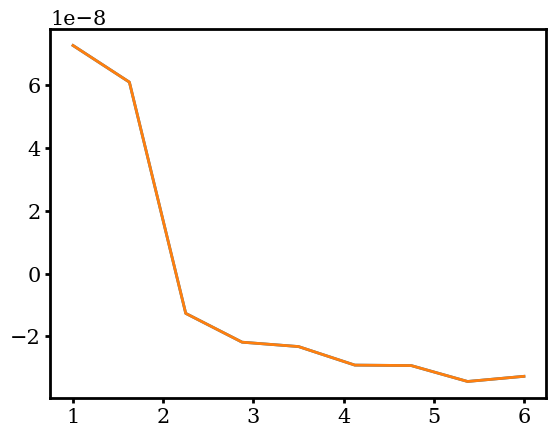

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 201.28113632675547 dec= 10.238048778363385
Map:
- min, mean, max = -0.09361624207890139 -0.0024997156930991753 3.678147721600579
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)
- filter on u

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -4.960230108880812
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: -1.0379358050187003e-08
- filter on mask: 0.0
- filter on inverse hit: -4.960230108880812
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0
T_

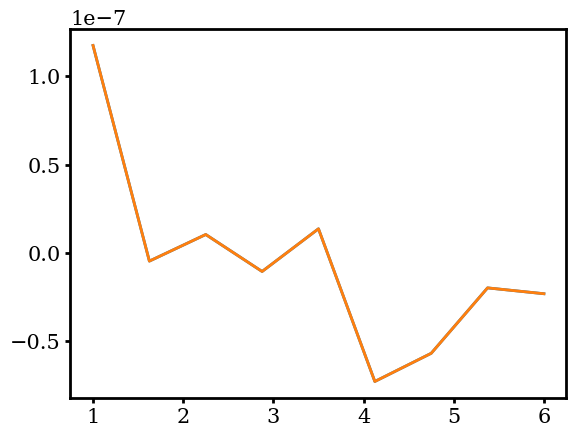

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.50385937895567 dec= 18.344040447135036
Map:
- min, mean, max = -0.08015337227516796 0.00010081277196149014 3.2745047622021457
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- disk area: 5.288496871297024e-09 sr, ie 0.06250000000000001arcmin^2
  (from r0, expect 0.0 sr, ie 0.0arcmin^2)
- disk-ring filter sums over pixels to 45.0
  (should be 0; compared to 4761)
- filter on 

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 250.0
No. pixels in ring= 171.0
T_large= -4.969300598812974
AP filter with disk radius = 2.25 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4590
+ nb of pixels where filter>0: 171
+ nb of pixels where filter<0: 0
- disk area: 1.3221242178242561e-06 sr, ie 15.625000000000004arcmin^2
  (from r0, expect 1.3457585364713461e-06 sr, ie 15.904312808798329arcmin^2)
- disk-ring filter sums over pixels to 171.0
  (should be 0; compared to 4761)
- filter on unit disk: 0.0
  (should be disk area in sr: 1.3221242178242561e-06)
- filter on map: 1.059621371745295e-08
- filter on mask: 0.0
- filter on inverse hit: -4.969300598812974
- plot the filter
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 421.0
No. pixels in ring= 190.0
T_la

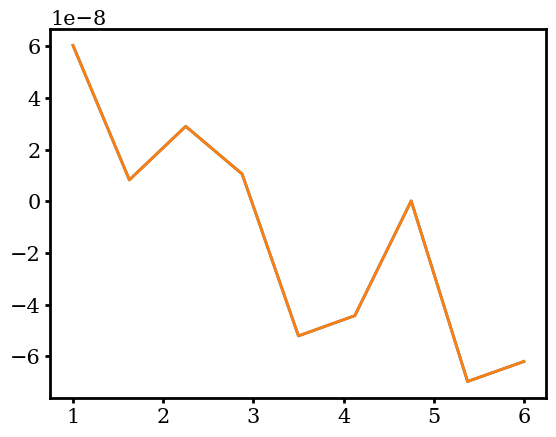

took 1.419718849658966 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
Measure var for each aperture (no hit count)
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping

/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/thumbstack.py:1231: RuntimeWarning: divide by zero encountered in divide
  norm = 1./np.sum(Tlarge**2, axis=0)
/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/thumbstack.py:1248: RuntimeWarning: invalid value encountered in multiply
  stack = norm * np.sum(t * weights, axis=0)
/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/thumbstack.py:1249: RuntimeWarning: invalid value encountered in multiply
  sStack = norm * np.sqrt(np.sum(s2Full * weights**2, axis=0))
/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/thumbstack.py:1235: RuntimeWarning: divide by zero encountered in divide
  norm = 1./np.sum(np.abs(Tlarge), axis=0)


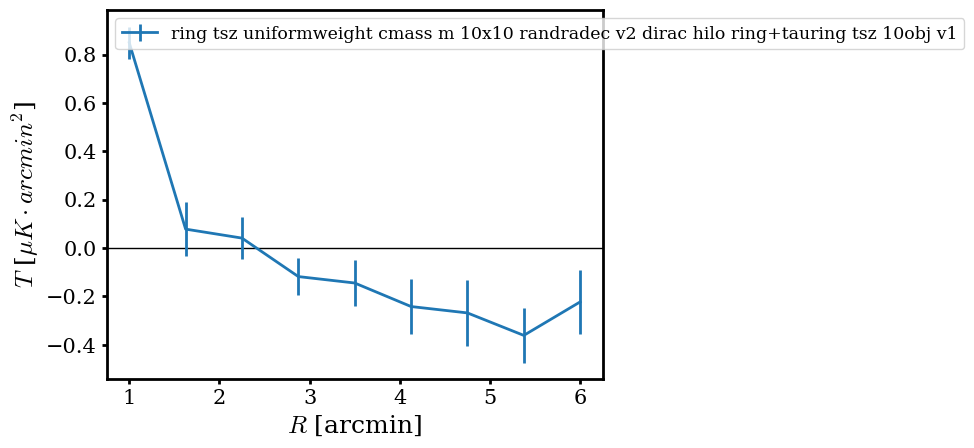

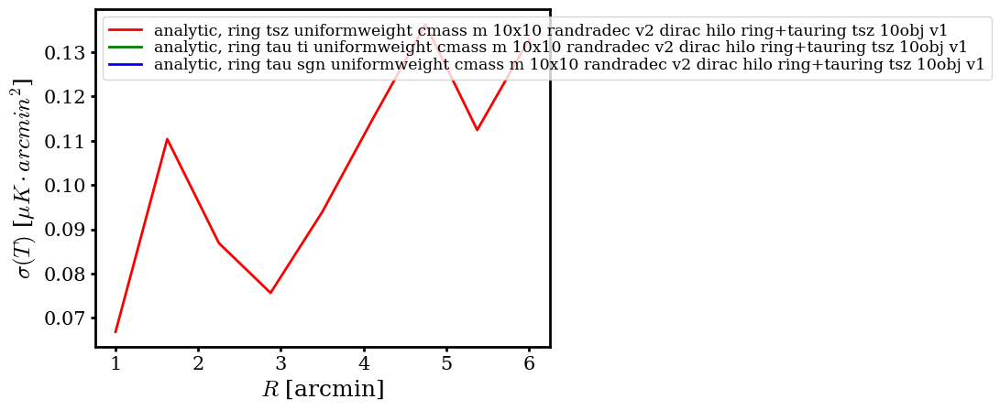

/home/theo/miniforge3/envs/tau_py3.8/lib/python3.8/site-packages/matplotlib/axes/_base.py:2532: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


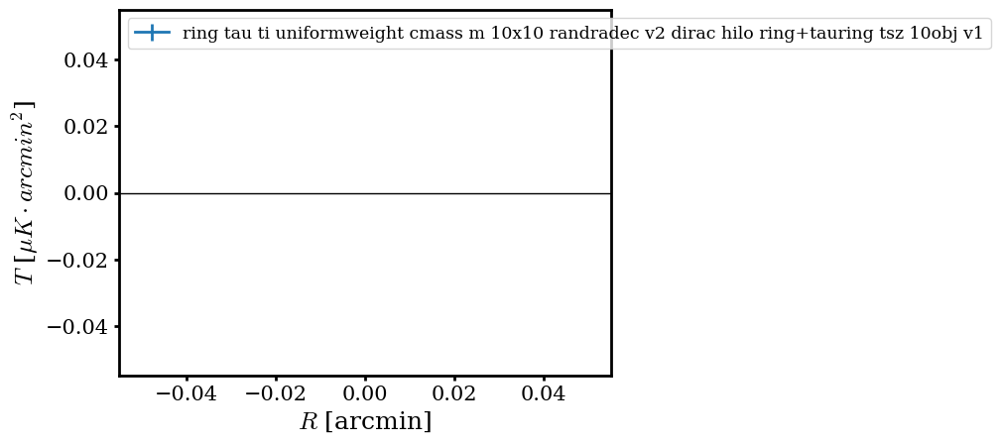

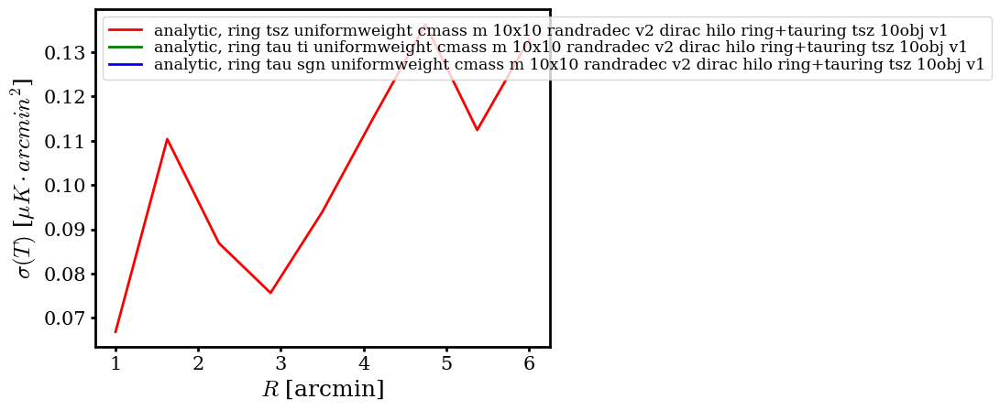

/home/theo/miniforge3/envs/tau_py3.8/lib/python3.8/site-packages/matplotlib/axes/_base.py:2532: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


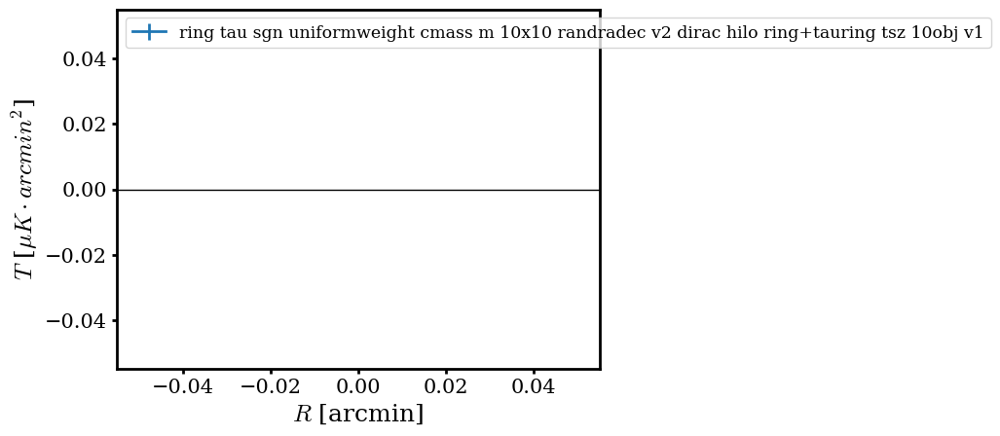

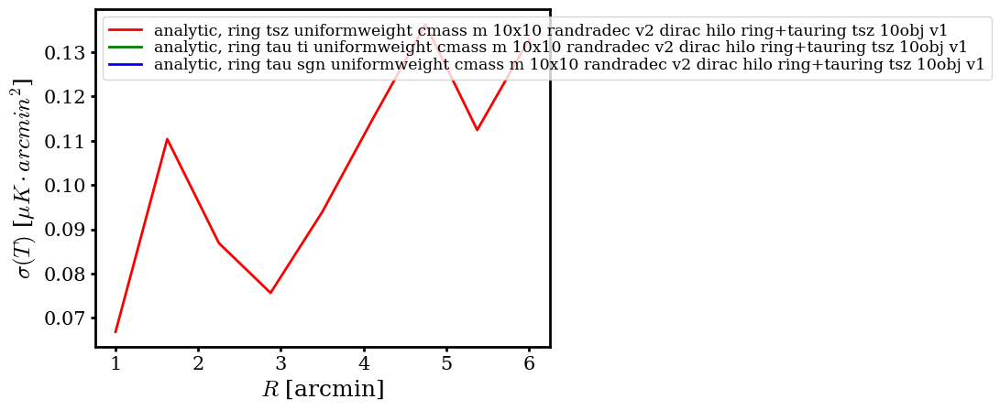

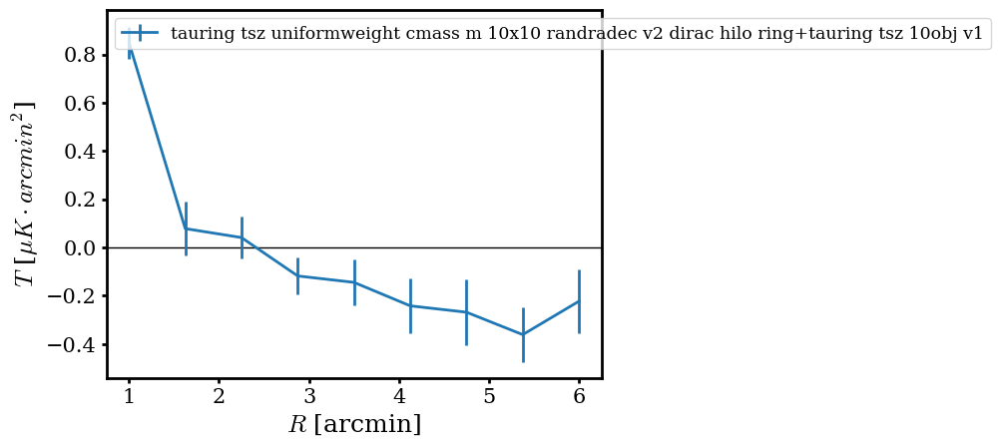

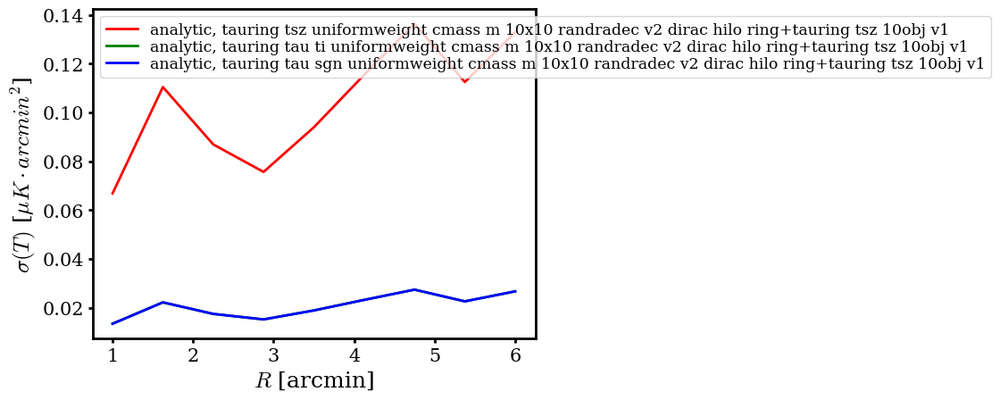

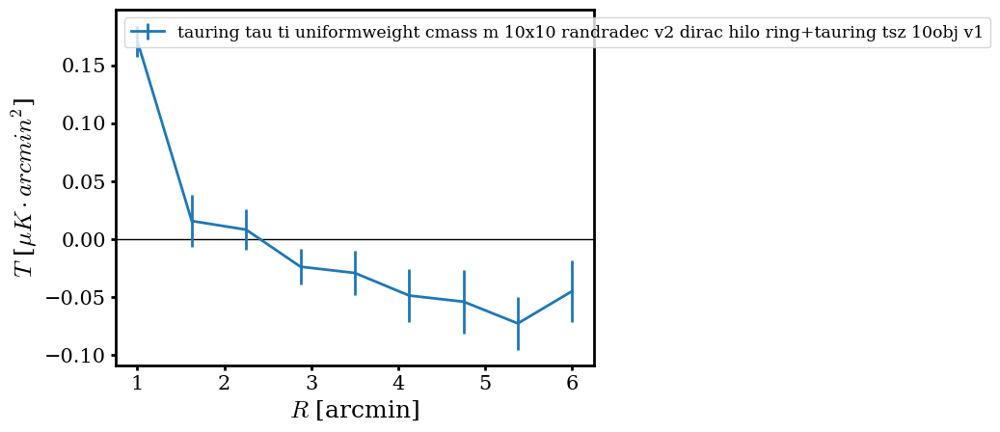

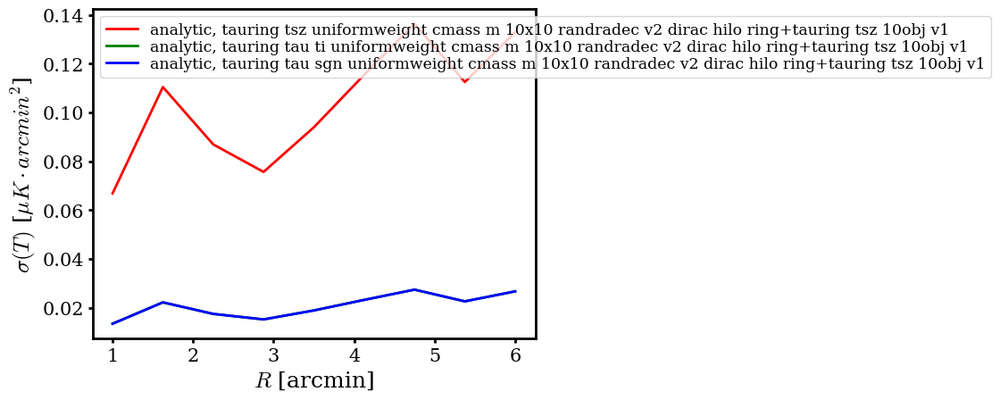

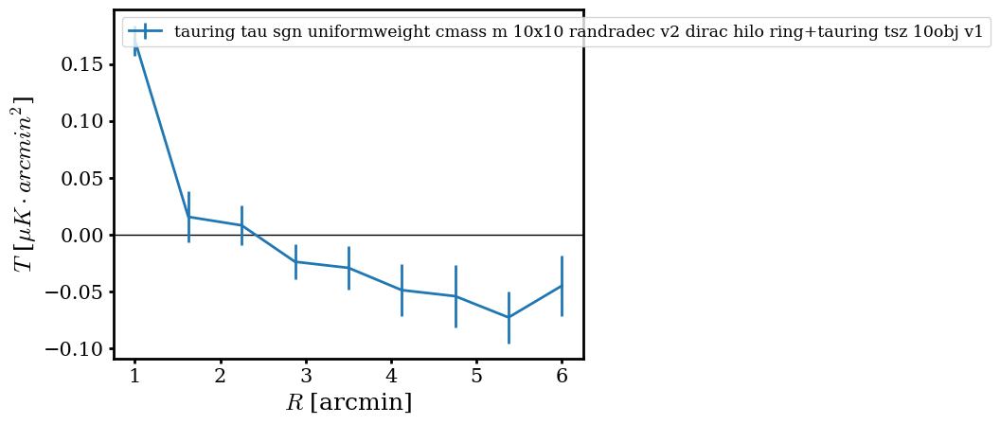

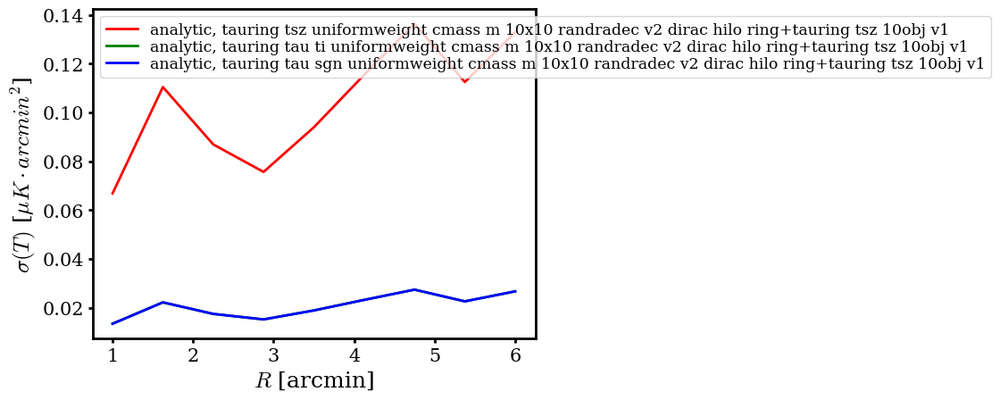

- plot all covariances
- compute all SNR and significances
- compute all stacked maps
compute stacked map: ring tsz_uniformweight
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analyze object 0
saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_dirac_hilo_ring+tauring_tsz_10obj_v1/stackedmap_ring_tsz_uniformweight.pdf
compute stacked map: ring tau_ti_uniformweight
- Compute stacked profile: ring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end


/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/thumbstack.py:1231: RuntimeWarning: divide by zero encountered in divide
  norm = 1./np.sum(Tlarge**2, axis=0)


- analyze object 0


/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/thumbstack.py:1302: RuntimeWarning: invalid value encountered in multiply
  resMap *= norm


saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_dirac_hilo_ring+tauring_tsz_10obj_v1/stackedmap_ring_tau_ti_uniformweight.pdf
compute stacked map: ring tau_sgn_uniformweight
- Compute stacked profile: ring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end


/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/thumbstack.py:1235: RuntimeWarning: divide by zero encountered in divide
  norm = 1./np.sum(np.abs(Tlarge), axis=0)


- analyze object 0


/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/thumbstack.py:1302: RuntimeWarning: invalid value encountered in multiply
  resMap *= norm


saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_dirac_hilo_ring+tauring_tsz_10obj_v1/stackedmap_ring_tau_sgn_uniformweight.pdf
compute stacked map: tauring tsz_uniformweight
- Compute stacked profile: tauring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analyze object 0
saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_dirac_hilo_ring+tauring_tsz_10obj_v1/stackedmap_tauring_tsz_uniformweight.pdf
compute stacked map: tauring tau_ti_uniformweight
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of 

<Figure size 640x480 with 0 Axes>

In [31]:
# testing on 10 objects: dirac profiles
name = 'cmass_m_10x10_randradec_v2'
cmass_10x10_rand = Catalog(u, massConversion, name=name, nObj=10)

save=True
bootstrap=False
test=True
stackMap=True
idx = 0
name = cmass_10x10_rand.name + '_dirac_hilo_ring+tauring_tsz_10obj_v1'
hi_enmap = enmap.enmap(hi_map_list[idx].data, wcs)
lo_enmap = enmap.enmap(lo_map_list[idx].data, wcs)
ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, hi_enmap, boxMask, cmbMap2=lo_enmap, 
    cmbHit=None, name=name, nameLong=None, save=save, nProc=nProc, filterTypes=['ring', 'tauring'],
    doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

- load full catalog from ./output/catalog/cmass_m_10x10_randradec_v2/catalog.txt
- Thumbstack: cmass_m_10x10_randradec_v2_gauss_hilo_tauring_tsz_10obj_v1
Checking the mMax bins:
number of bins: 20 20
values of mMax: [4.02159276e+12 4.54179873e+12 5.12929501e+12 5.79278582e+12
 6.54210131e+12 7.38834317e+12 8.34404913e+12 9.42337874e+12
 1.06423231e+13 1.20189419e+13 1.35736307e+13 1.53294235e+13
 1.73123337e+13 1.95517398e+13 2.20808203e+13 2.49370454e+13
 2.81627325e+13 3.18056726e+13 3.59198387e+13 4.05661854e+13]
Create overlap flag
- 0
took 0.00019910732905069987 min
Out of 10 objects, 10.0 overlap, ie a fraction 1.0
Evaluate all filters on all objects
- analyze object 0
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixe

 plot the measured profile


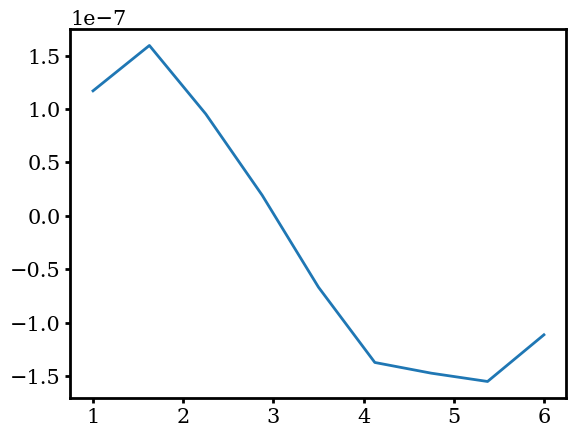

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.3887843975205 dec= 19.63657442610793
Map:
- min, mean, max = -0.48557612494859925 -0.004391121492467394 1.1178331509989867
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.756697790864295
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- 

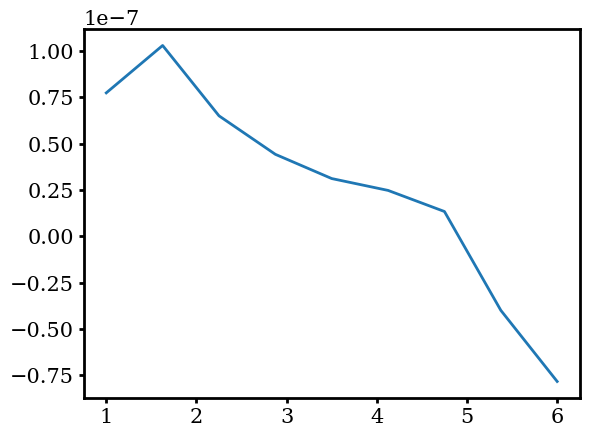

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 208.58597919911384 dec= 19.114872052347895
Map:
- min, mean, max = -0.3076548679299296 -0.04798925731258377 0.681478927780861
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.929181114737632
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- d

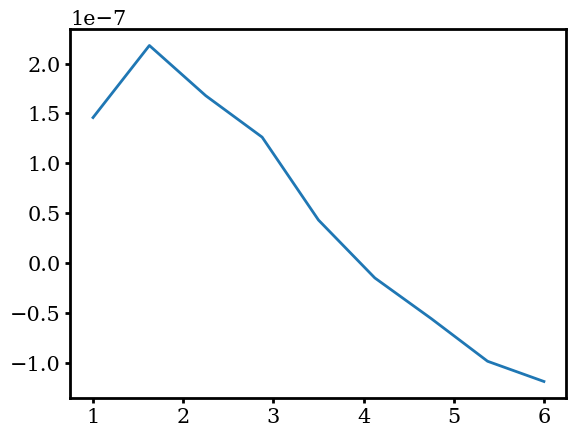

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 206.97368029059365 dec= 19.72905100211363
Map:
- min, mean, max = -0.47447516882405244 -0.022326909851462413 1.315422549187895
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.676834005768221
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- 

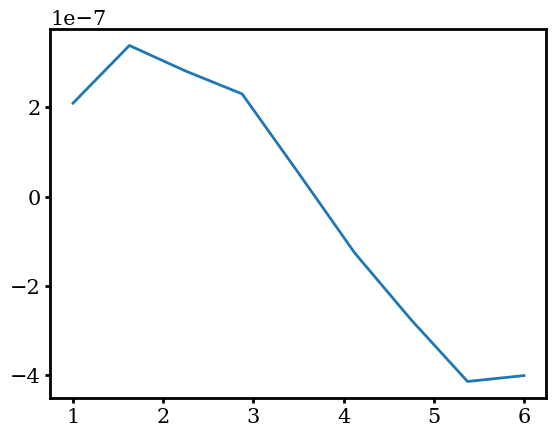

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 200.94177347887648 dec= 19.96919572209523
Map:
- min, mean, max = -0.3074467703747984 0.009462099361222198 0.5349082748011162
- plot
Mask:
- min, mean, max = 0.0 0.5797101449275363 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -2.9150094118730476
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where

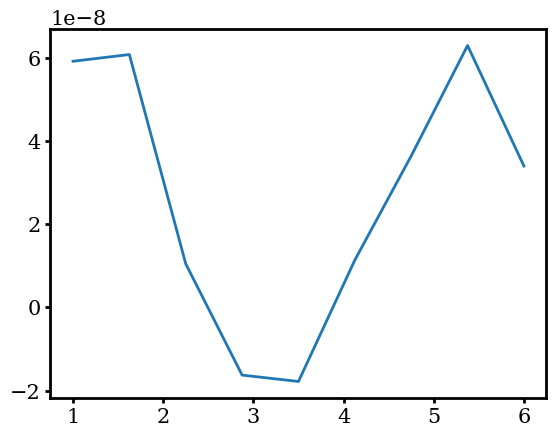

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 209.75622351636756 dec= 16.69800095180972
Map:
- min, mean, max = -0.4722222934754343 -0.005464940789311839 1.079684852264445
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.73946894170584
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- di

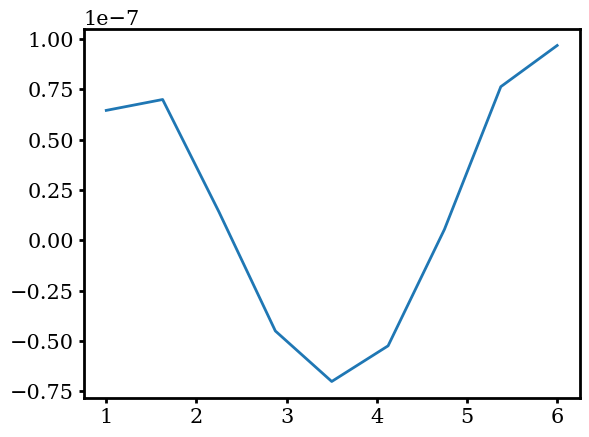

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.61139701990354 dec= 14.516854958057447
Map:
- min, mean, max = -0.3623745101930109 -0.021393909927979675 0.7272245061877411
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.788892549646295
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
-

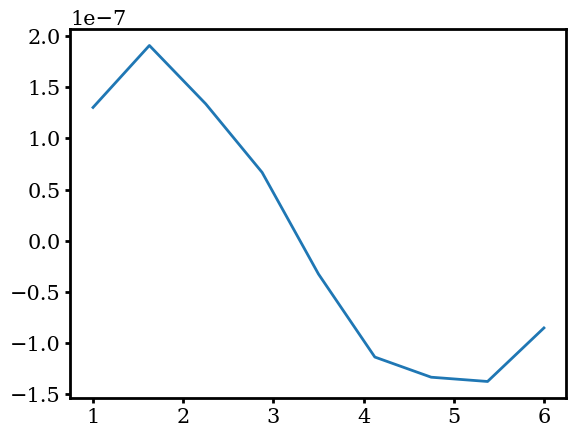

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.86064305276955 dec= 18.507339014963048
Map:
- min, mean, max = -0.3444767711700945 0.006668292167639108 1.0468173185742136
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.8088219171344635
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
-

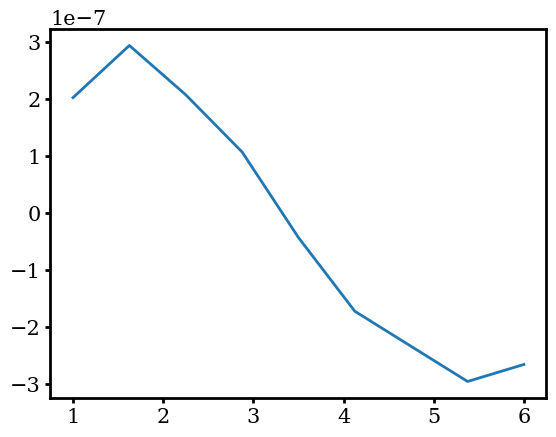

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 201.28113632675547 dec= 10.238048778363385
Map:
- min, mean, max = -0.6806569699600062 -0.03208652646897133 1.0997503672697764
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.5874203660037445
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
-

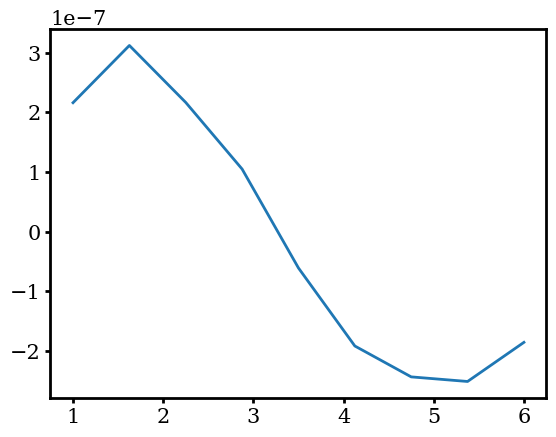

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.50385937895567 dec= 18.344040447135036
Map:
- min, mean, max = -0.4558236115237302 0.009106915839478086 0.8184556736164619
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -4.701630712348062
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- 

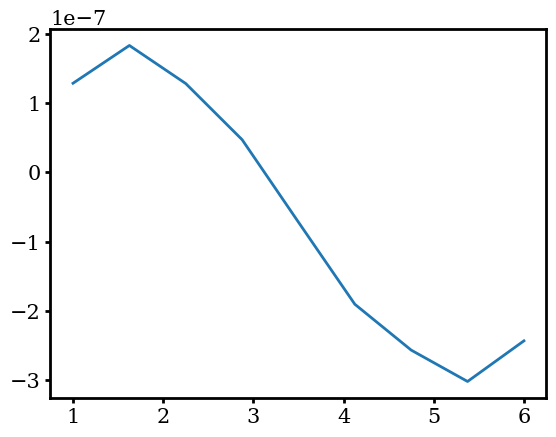

took 0.8832791924476624 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: tauring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
T filtMap: [[ 1.16996875e-07  1.59411727e-07  9.53900288e-08  1.94833625e-08
  -6.65909268e-08 -1.36994904e-07 -1.46992142e-07 -1.54762999e-07
  -1.11114708e-07]
 [ 7.74175742e-08  1.03002974e-07  6.50274190e-08  4.42428054e-08
   3.11597291e-08  2.47568225e-08  1.33709947e-08 -3.99755

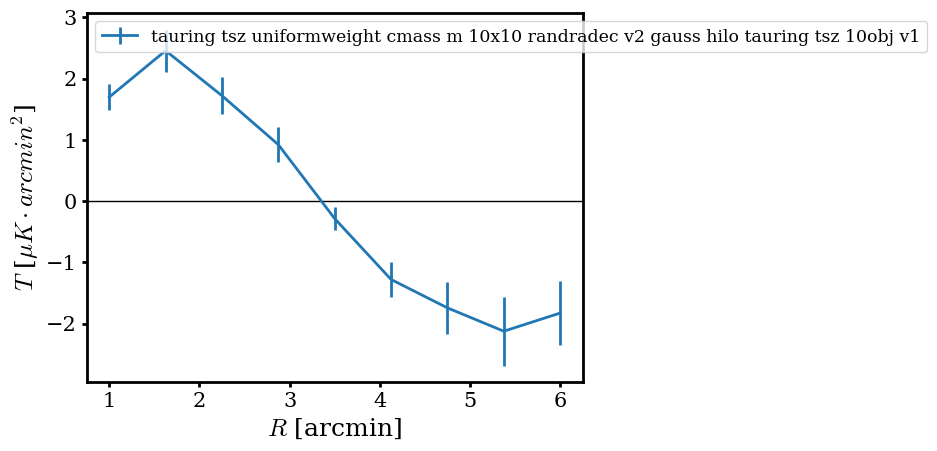

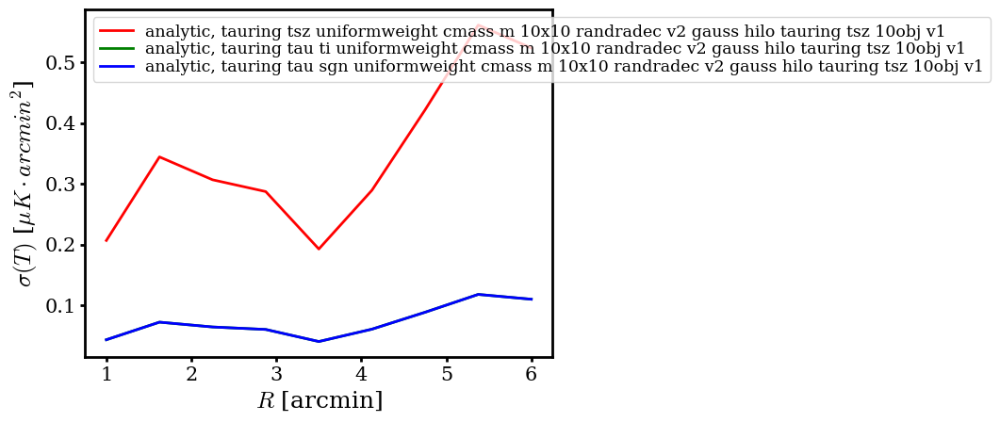

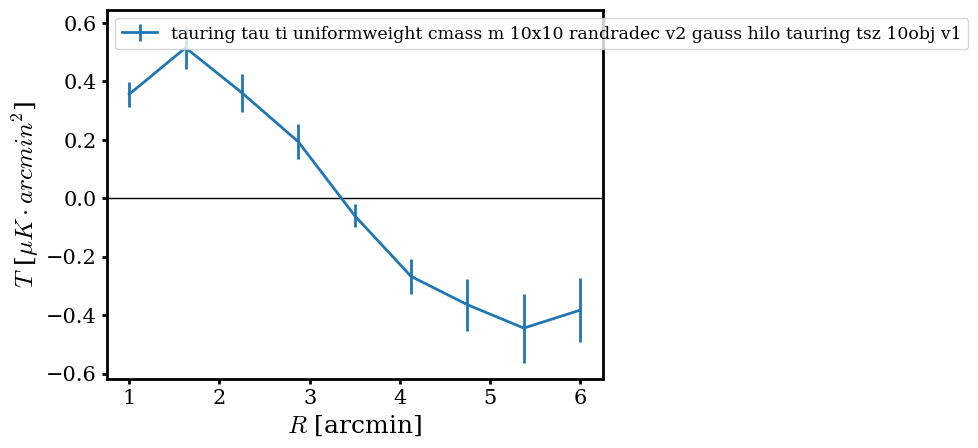

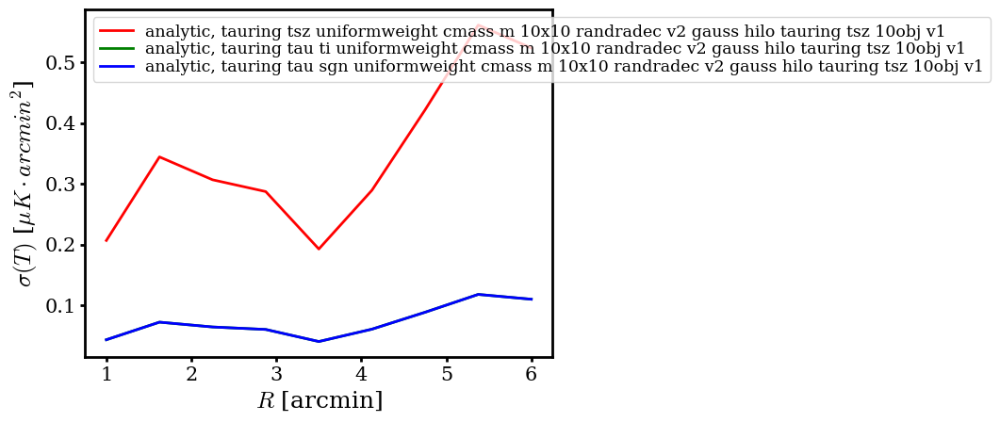

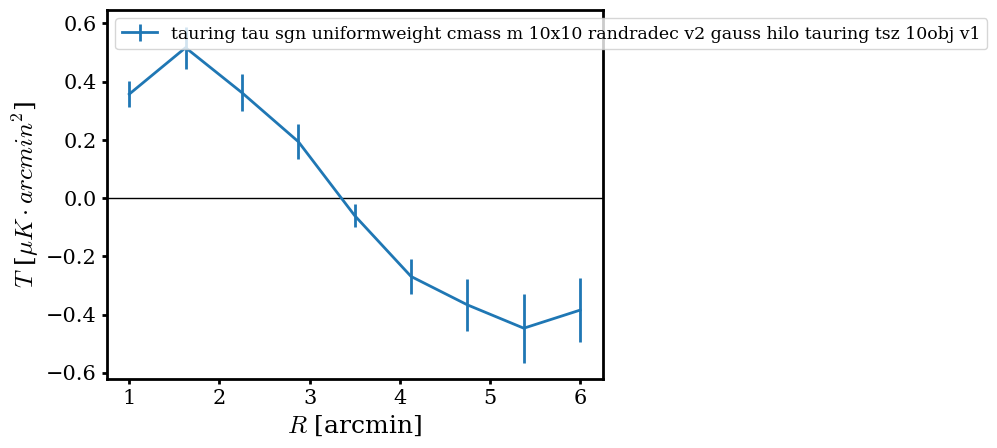

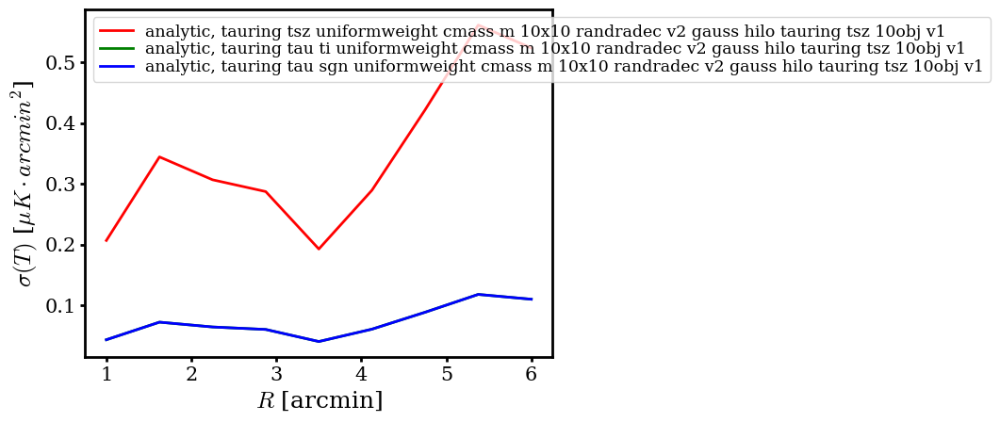

- plot all covariances
- compute all SNR and significances
- compute all stacked maps
compute stacked map: tauring tsz_uniformweight
- Compute stacked profile: tauring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analyze object 0
saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_gauss_hilo_tauring_tsz_10obj_v1/stackedmap_tauring_tsz_uniformweight.pdf
compute stacked map: tauring tau_ti_uniformweight
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analy

<Figure size 640x480 with 0 Axes>

In [30]:
# testing on 10 objects: gaussian profiles
name = 'cmass_m_10x10_randradec_v2'
cmass_10x10_rand = Catalog(u, massConversion, name=name, nObj=10)

save=True
bootstrap=False
test=True
stackMap=True
idx = 1
name = cmass_10x10_rand.name + '_gauss_hilo_ring+tauring_tsz_10obj_v1'
hi_enmap = enmap.enmap(hi_map_list[idx].data, wcs)
lo_enmap = enmap.enmap(lo_map_list[idx].data, wcs)
ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, hi_enmap, boxMask, cmbMap2=lo_enmap, 
    cmbHit=None, name=name, nameLong=None, save=save, nProc=nProc, filterTypes=['ring', 'tauring'],
    doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

- load full catalog from ./output/catalog/cmass_m_10x10_randradec_v2/catalog.txt
- Thumbstack: cmass_m_10x10_randradec_v2_const_hilo_tauring_10obj_v1
Checking the mMax bins:
number of bins: 20 20
values of mMax: [4.02159276e+12 4.54179873e+12 5.12929501e+12 5.79278582e+12
 6.54210131e+12 7.38834317e+12 8.34404913e+12 9.42337874e+12
 1.06423231e+13 1.20189419e+13 1.35736307e+13 1.53294235e+13
 1.73123337e+13 1.95517398e+13 2.20808203e+13 2.49370454e+13
 2.81627325e+13 3.18056726e+13 3.59198387e+13 4.05661854e+13]
Create overlap flag
- 0
took 0.00021192630132039388 min
Out of 10 objects, 10.0 overlap, ie a fraction 1.0
Evaluate all filters on all objects
- analyze object 0
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(r

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: -7.463215750730138e-24
- filter on map [map unit * arcmin^2]: -8.820105140881643e-17
 filter on map / area [map unit]: -4.225200067488212e-18
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


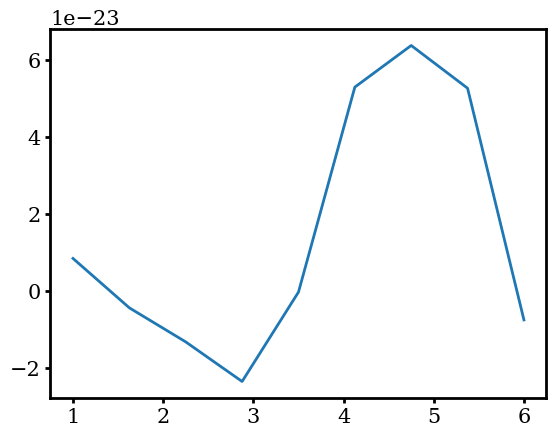

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.3887843975205 dec= 19.63657442610793
Map:
- min, mean, max = -2.2918402473969713e-16 -1.0617424644841498e-17 2.7438235321683584e-16
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring 

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: -2.567572963362938e-23
- filter on map [map unit * arcmin^2]: -3.034384138168677e-16
 filter on map / area [map unit]: -1.4535971919370904e-17
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


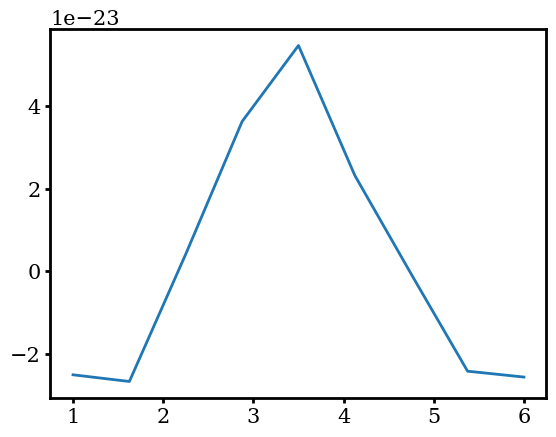

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 208.58597919911384 dec= 19.114872052347895
Map:
- min, mean, max = -1.9353131786887007e-16 -3.1873890885630804e-18 2.140708178256081e-16
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: -2.0199153835116987e-24
- filter on map [map unit * arcmin^2]: -2.3871567770923004e-17
 filter on map / area [map unit]: -1.1435481566909222e-18
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


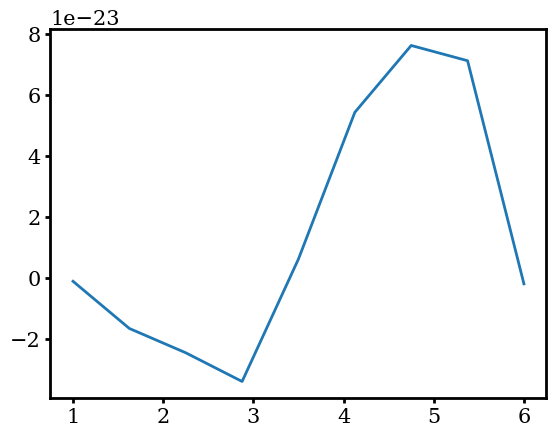

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 206.97368029059365 dec= 19.72905100211363
Map:
- min, mean, max = -1.697517509548604e-16 3.3400909393997317e-18 2.1406938215738865e-16
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring a

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: 1.74454986542403e-23
- filter on map [map unit * arcmin^2]: 2.0617269754054103e-16
 filter on map / area [map unit]: 9.876536409127713e-18
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


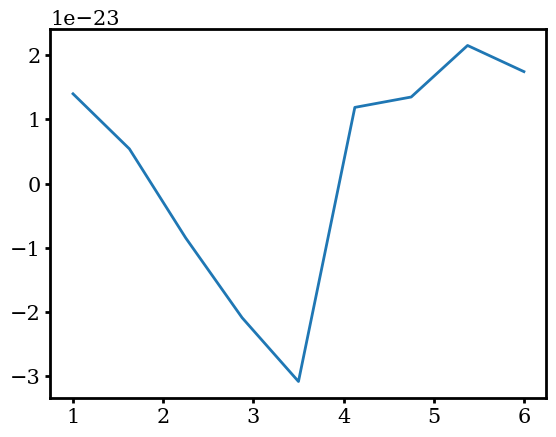

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 200.94177347887648 dec= 19.96919572209523
Map:
- min, mean, max = -1.697329780864805e-16 -2.451973333397831e-17 1.0516591218030545e-16
- plot
Mask:
- min, mean, max = 0.0 0.5797101449275363 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -3.012802671861954
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixe

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -3.012802671861954
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: 1.1065483337483938e-23
- filter on map [map unit * arcmin^2]: 1.307730202784691e-16
 filter on map / area [map unit]: 6.264575821723071e-18
- filter on mask: 636.0
- filter on inverse hit (or Tlarge): -3.012802671861954
- plot the filter
 plot the measured pro

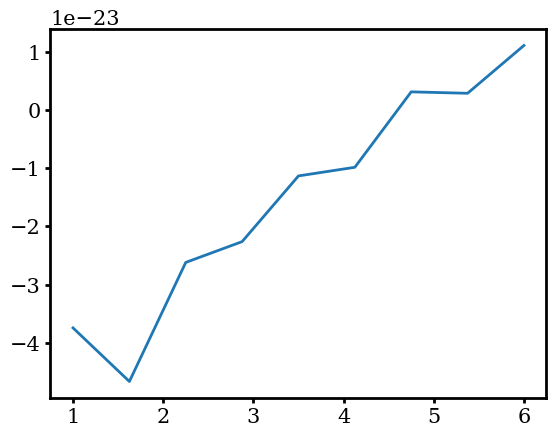

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 209.75622351636756 dec= 16.69800095180972
Map:
- min, mean, max = -2.8253983652251686e-16 6.242029815182952e-19 2.2862740674886746e-16
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring a

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: 1.5433452417736927e-23
- filter on map [map unit * arcmin^2]: 1.8239412815838323e-16
 filter on map / area [map unit]: 8.737443265072248e-18
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


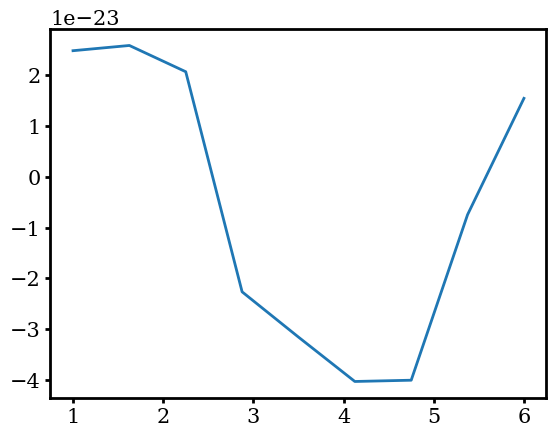

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.61139701990354 dec= 14.516854958057447
Map:
- min, mean, max = -2.747809614735641e-16 5.5998390976875066e-18 3.1492063139063455e-16
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring 

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: 9.699095661910902e-24
- filter on map [map unit * arcmin^2]: 1.146249101818529e-16
 filter on map / area [map unit]: 5.491013661406126e-18
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


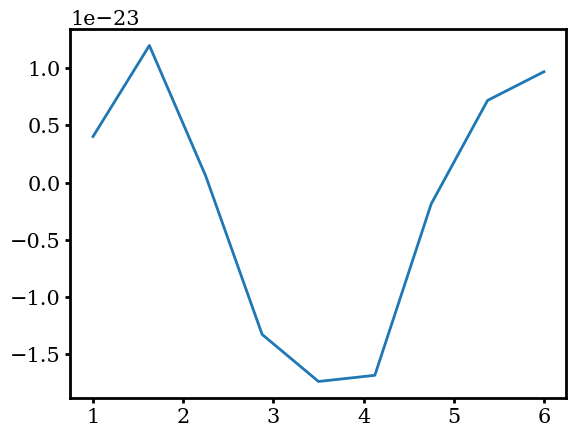

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 207.86064305276955 dec= 18.507339014963048
Map:
- min, mean, max = -2.7479134183577274e-16 -1.7031318824505508e-17 3.1473865150835383e-16
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- rin

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: -1.0326452205352378e-23
- filter on map [map unit * arcmin^2]: -1.2203907434216485e-16
 filter on map / area [map unit]: -5.846183202019872e-18
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


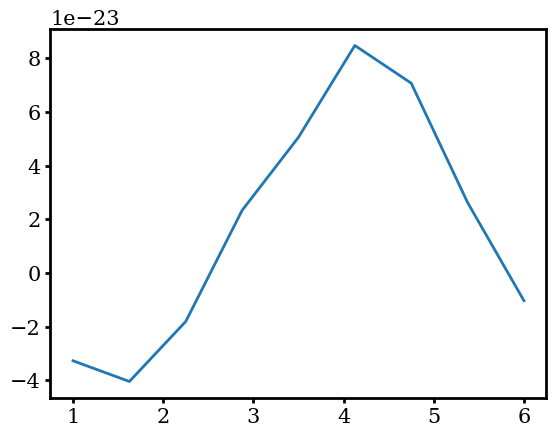

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 201.28113632675547 dec= 10.238048778363385
Map:
- min, mean, max = -2.276918433143925e-16 8.277354856504447e-18 2.768484717035027e-16
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring ar

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: 5.755486266223238e-24
- filter on map [map unit * arcmin^2]: 6.801892870378692e-17
 filter on map / area [map unit]: 3.2583917941933843e-18
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


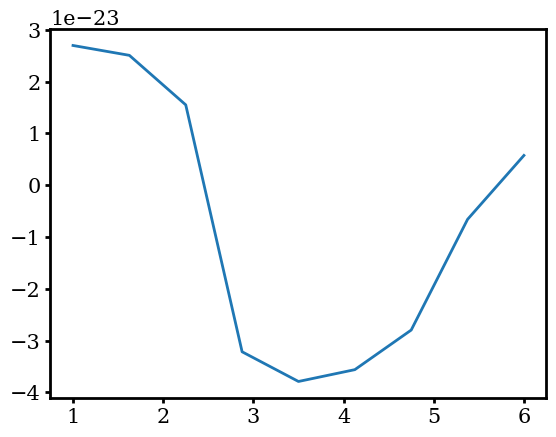

cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
cutout sides are dx, dy = 17.25 , 17.25 arcmin
cutout pixel dimensions are (69, 69)
hence a cutout resolution of 0.25 , 0.25 arcmin per pixel
(requested 0.25 arcmin per pixel)
Extracted cutouts around ra= 204.50385937895567 dec= 18.344040447135036
Map:
- min, mean, max = -2.280280904497192e-16 1.5714825469396075e-17 2.7578621390404317e-16
- plot
Mask:
- min, mean, max = 1.0 1.0 1.0
- plot
Hit count:
- min, mean, max = 0.0 0.0 0.0
- plot the hit
Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1.0
No. pixels in ring= 45.0
T_large= -5.0
AP filter with disk radius = 0.0 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4716
+ nb of pixels where filter>0: 45
+ nb of pixels where filter<0: 0
- ring 

Filter type: tauring
T_large disk radius [rad]= 0.0024682682989768706
No. pixels in stamp= 4761
No. pixels in big disk= 3593.0
No. pixels in disk= 1457.0
No. pixels in ring= 334.0
T_large= -5.0
AP filter with disk radius = 5.375 arcmin
- nb of pixels in the cutout: 4761
= nb of pixels where filter=0: 4427
+ nb of pixels where filter>0: 334
+ nb of pixels where filter<0: 0
- ring area: 1.766357955013206e-06 sr, ie 20.875000000000004arcmin^2
  (from r0 and r1, expect 1.8898769570816756e-06 sr, ie 22.33476027161495arcmin^2)
- ring filter sums over pixels to 334.0
  (should be: 334.000000)
- filter on unit ring:  1.7663579550132063e-06
  (should be ring area in sr: 1.766357955013206e-06)
- filter on map [map unit * sr]: -7.662699594870303e-24
- filter on map [map unit * arcmin^2]: -9.055857199778155e-17
 filter on map / area [map unit]: -4.338135185522469e-18
- filter on mask: 0.0
- filter on inverse hit (or Tlarge): -5.0
- plot the filter
 plot the measured profile


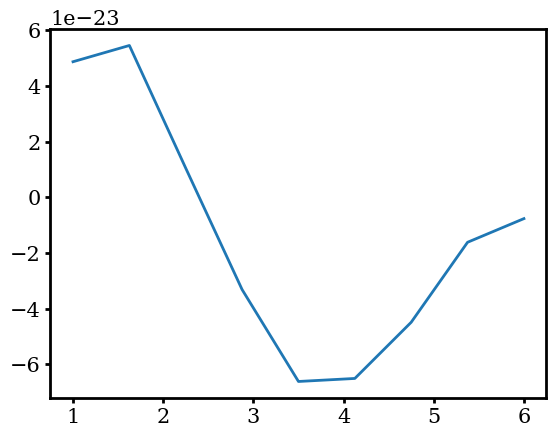

took 0.802340813477834 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
T filtMap: [[ 8.48975763e-24 -4.33976939e-24 -1.31808939e-23 -2.34575883e-23
  -2.46082665e-25  5.29819388e-23  6.37977095e-23  5.26995152e-23
  -7.46321575e-24]
 [-2.51267884e-23 -2.67443761e-23  4.11611943e-24  3.62427274e-23
   5.46648898e-23  2.31744408e-23 -7.14398000e-25 -2.424

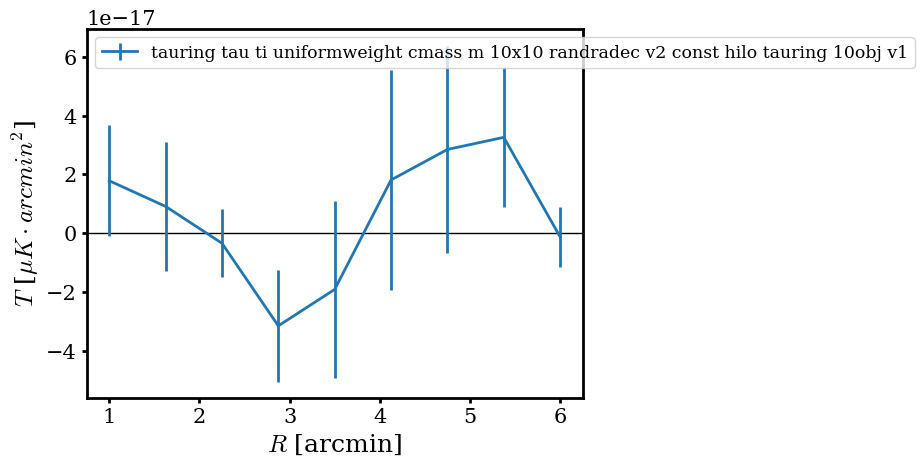

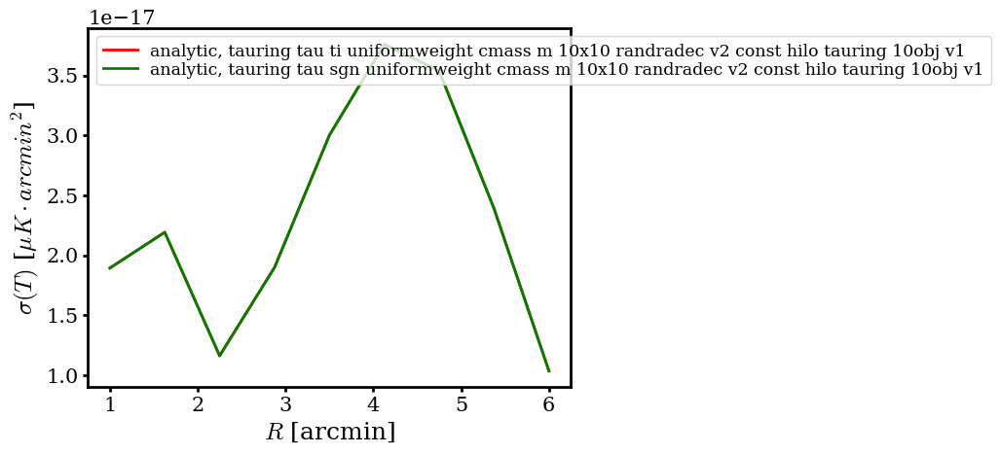

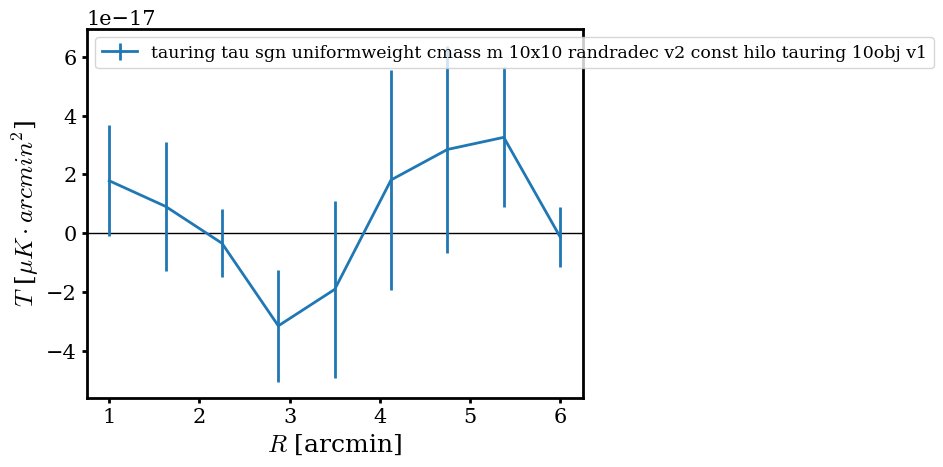

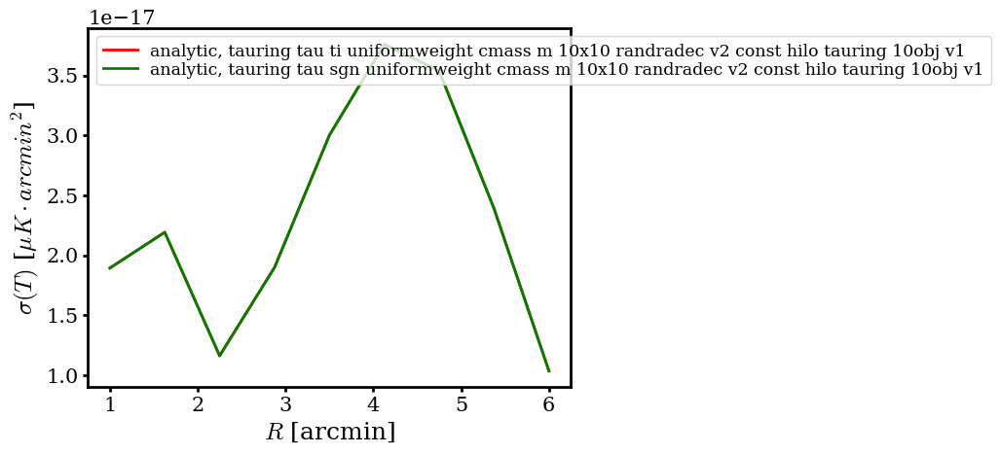

- plot all covariances
- compute all SNR and significances
- compute all stacked maps
compute stacked map: tauring tau_ti_uniformweight
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end
- analyze object 0
saving plot to ./figures/thumbstack/cmass_m_10x10_randradec_v2_const_hilo_tauring_10obj_v1/stackedmap_tauring_tau_ti_uniformweight.pdf
compute stacked map: tauring tau_sgn_uniformweight
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects after further overlap cut
keeping fraction 0.9 of objects after PS mask
keeping fraction 0.9 in the end


<Figure size 640x480 with 0 Axes>

In [85]:
# testing on 10 objects: constant map
name = 'cmass_m_10x10_randradec_v2'
cmass_10x10_rand = Catalog(u, massConversion, name=name, nObj=10)

save=True
bootstrap=False
test=True
stackMap=True
idx = 2
name = cmass_10x10_rand.name + '_const_hilo_tauring_10obj_v1'
hi_enmap = enmap.enmap(hi_map_list[idx].data, wcs)
lo_enmap = enmap.enmap(lo_map_list[idx].data, wcs)
ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, hi_enmap, boxMask, cmbMap2=lo_enmap, 
    cmbHit=None, name=name, nameLong=None, save=save, nProc=nProc, filterTypes='tauring',
    doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

## YAY!!

## Let's do on full catalog with bootstrap errors

- load full catalog from ./output/catalog/cmass_m_10x10_randradec_v2/catalog.txt
- Thumbstack: cmass_m_10x10_randradec_v2_dirac_hilo_tauring_v1
Create overlap flag
- 0
took 0.08436261812845866 min
Out of 7676 objects, 7666.0 overlap, ie a fraction 0.9986972381448671
Evaluate all filters on all objects
- analyze object 0
took 3.00026851495107 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mas

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, ta

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of 

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with frac

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
-

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 i

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the endof objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked pro

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0  0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of o

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


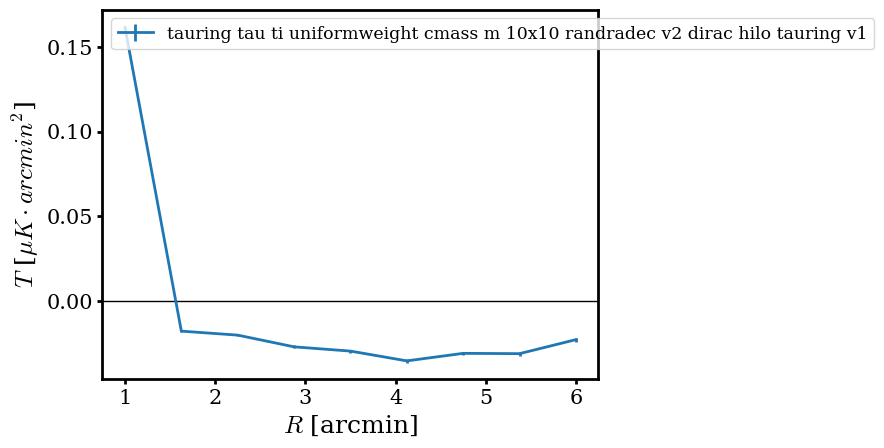

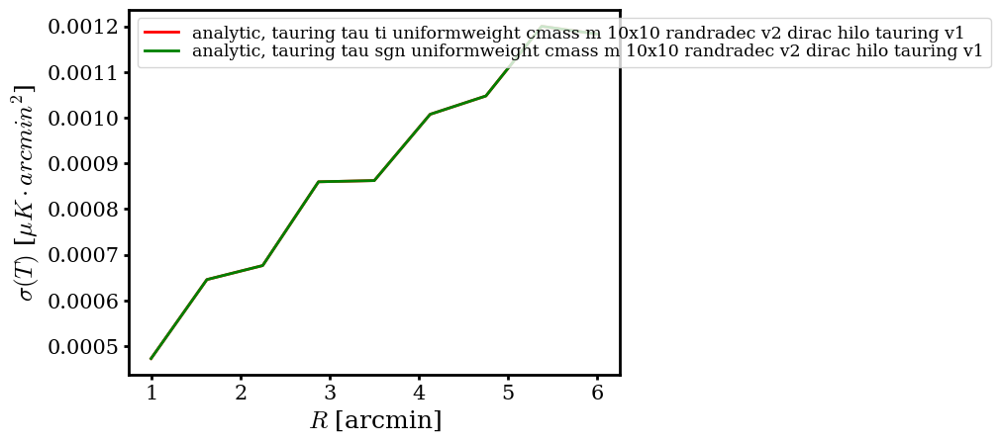

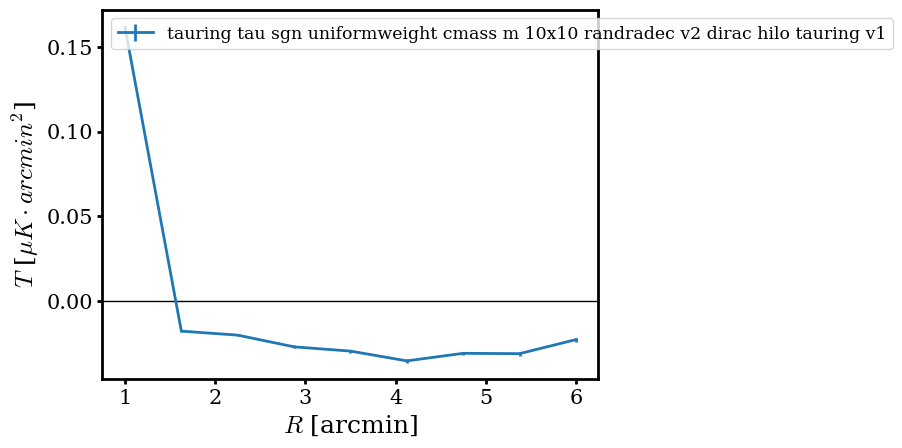

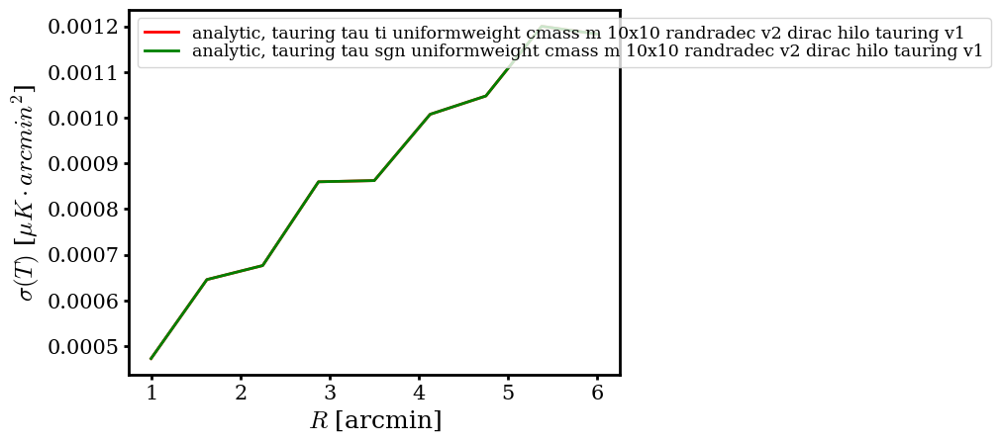

- plot all covariances
- compute all SNR and significances
- compute SNR and significances for tauring tau_ti_uniformweight 
- compute SNR and significances for tauring tau_ti_uniformweight tsz
- compute SNR and significances for tauring tau_ti_uniformweight ksz
- compute SNR and significances for tauring tau_sgn_uniformweight 
- compute SNR and significances for tauring tau_sgn_uniformweight tsz
- compute SNR and significances for tauring tau_sgn_uniformweight ksz
- Thumbstack: cmass_m_10x10_randradec_v2_gauss_hilo_tauring_v1
Create overlap flag
- 0
took 0.13793611923853558 min
Out of 7676 objects, 7666.0 overlap, ie a fraction 0.9986972381448671
Evaluate all filters on all objects
- analyze object 0
took 3.111910649140676 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects a

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, 

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 o

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Com

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction  of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked pr

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.95

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 
of objects after PS maskkeeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fractionof objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fra

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 1.0 of objects after mass cut
keeping fractionof objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sg

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight,  1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut


keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: 

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start wit

- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fur

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction - Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut


keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping f

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_sgn_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of obje

<Figure size 640x480 with 0 Axes>

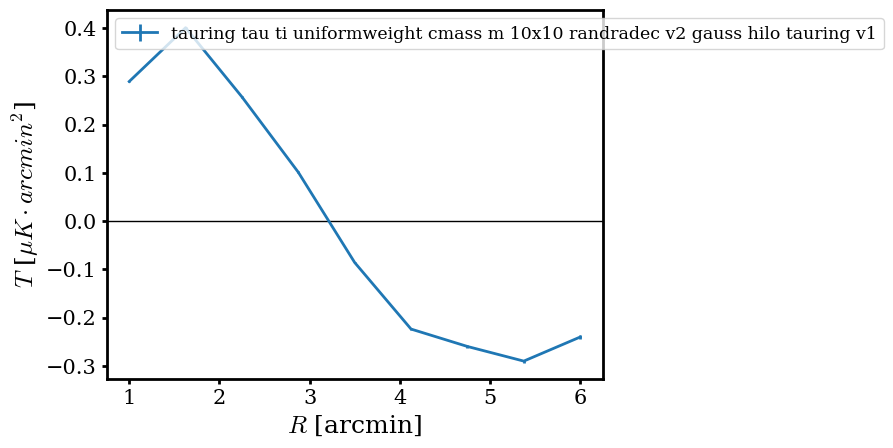

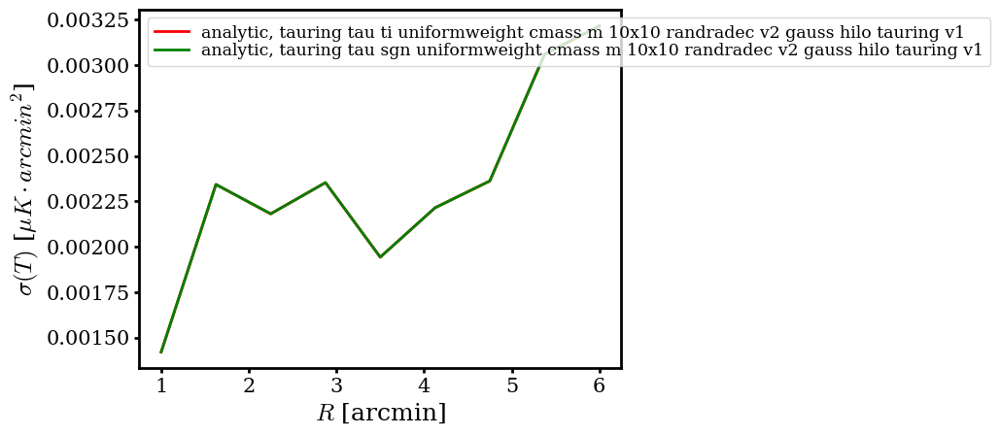

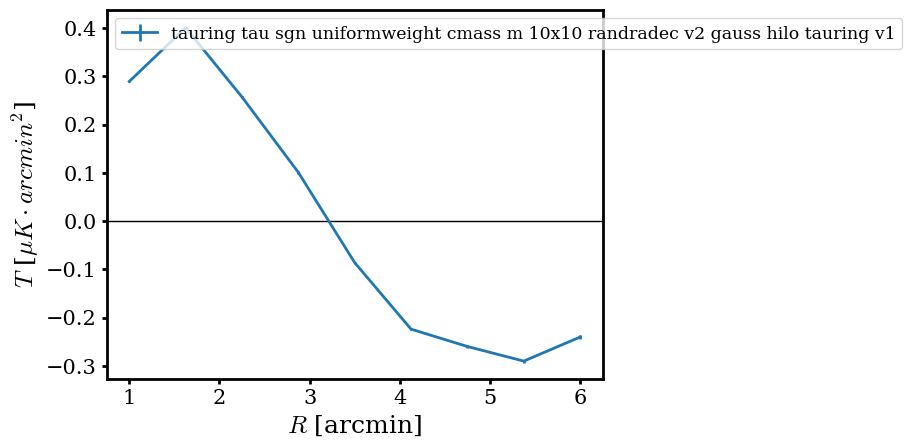

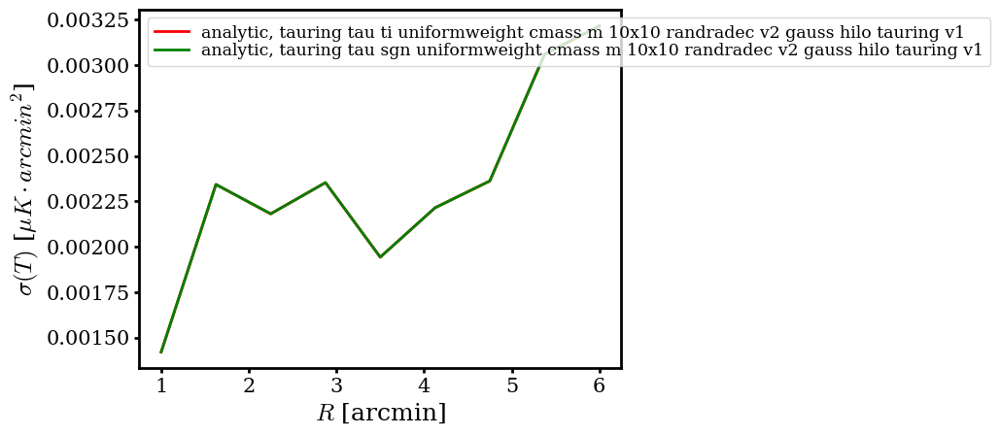

- plot all covariances
- compute all SNR and significances
- compute SNR and significances for tauring tau_ti_uniformweight 
- compute SNR and significances for tauring tau_ti_uniformweight tsz
- compute SNR and significances for tauring tau_ti_uniformweight ksz
- compute SNR and significances for tauring tau_sgn_uniformweight 
- compute SNR and significances for tauring tau_sgn_uniformweight tsz
- compute SNR and significances for tauring tau_sgn_uniformweight ksz
- Thumbstack: cmass_m_10x10_randradec_v2_const_hilo_tauring_v1
Create overlap flag
- 0
took 0.13387798468271891 min
Out of 7676 objects, 7666.0 overlap, ie a fraction 0.9986972381448671
Evaluate all filters on all objects
- analyze object 0
took 3.4443973302841187 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after P

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671  of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fra

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
k

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction1.0  of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
kee

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after furthe

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked p

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of object

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping frac

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: tauring, tau_ti_uniformweight, 
start with f

In [ ]:
# run on full cat with b/s
name = 'cmass_m_10x10_randradec_v2'
cmass_10x10_rand = Catalog(u, massConversion, name=name)

save=True
bootstrap=True
test=False
stackMap=False
names = ['dirac', 'gauss', 'const']
for idx in range(3):
    name = cmass_10x10_rand.name + '_%s_hilo_tauring_v1'%names[idx]
    hi_enmap = enmap.enmap(hi_map_list[idx].data, wcs)
    lo_enmap = enmap.enmap(lo_map_list[idx].data, wcs)
    ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, hi_enmap, boxMask, cmbMap2=lo_enmap, 
        cmbHit=None, name=name, nameLong=None, save=save, nProc=nProc, filterTypes='tauring',
        doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)

#### The above did save all plots / data files, just didn't print final output

In [ ]:
# make more realistic level for gaussian tau maps then run again
# also want to run on CMB only maps, with bootstrap enabled - done in run_tauring_filtered_CMB0_maps.ipynb

# Let's make a pure tau (gaussian profile) map with more realistic signal level ~10^-3

In [32]:
offsetDData = dData*1e-3 + factor * np.ones_like(dData)
offsetGData = gData*1e-2 + factor * np.ones_like(gData)
offsetDiracMap = baseMap.copy()
offsetGaussMap = baseMap.copy()
offsetDiracMap.data = offsetDData
offsetGaussMap.data = offsetGData
diracEnmap = enmap.enmap(offsetDiracMap.data, wcs)
gaussEnmap = enmap.enmap(offsetGaussMap.data, wcs)

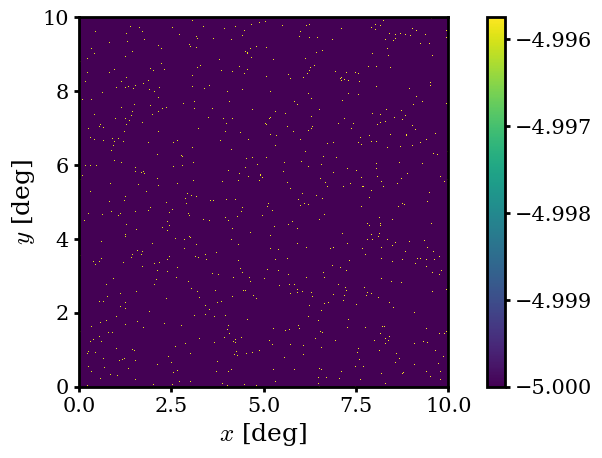

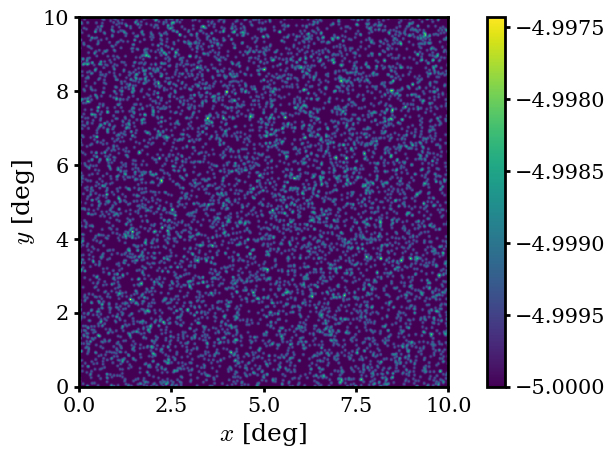

In [33]:
offsetDiracMap.plot()
offsetGaussMap.plot()

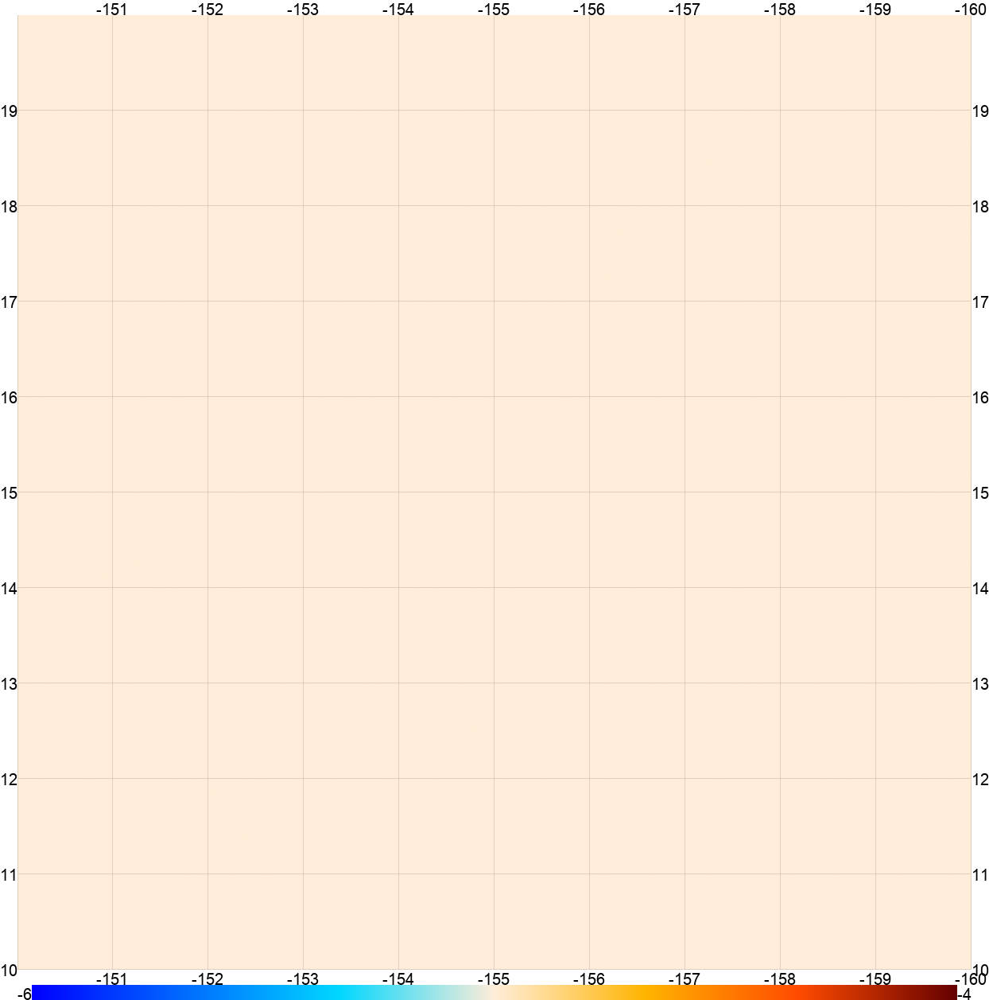

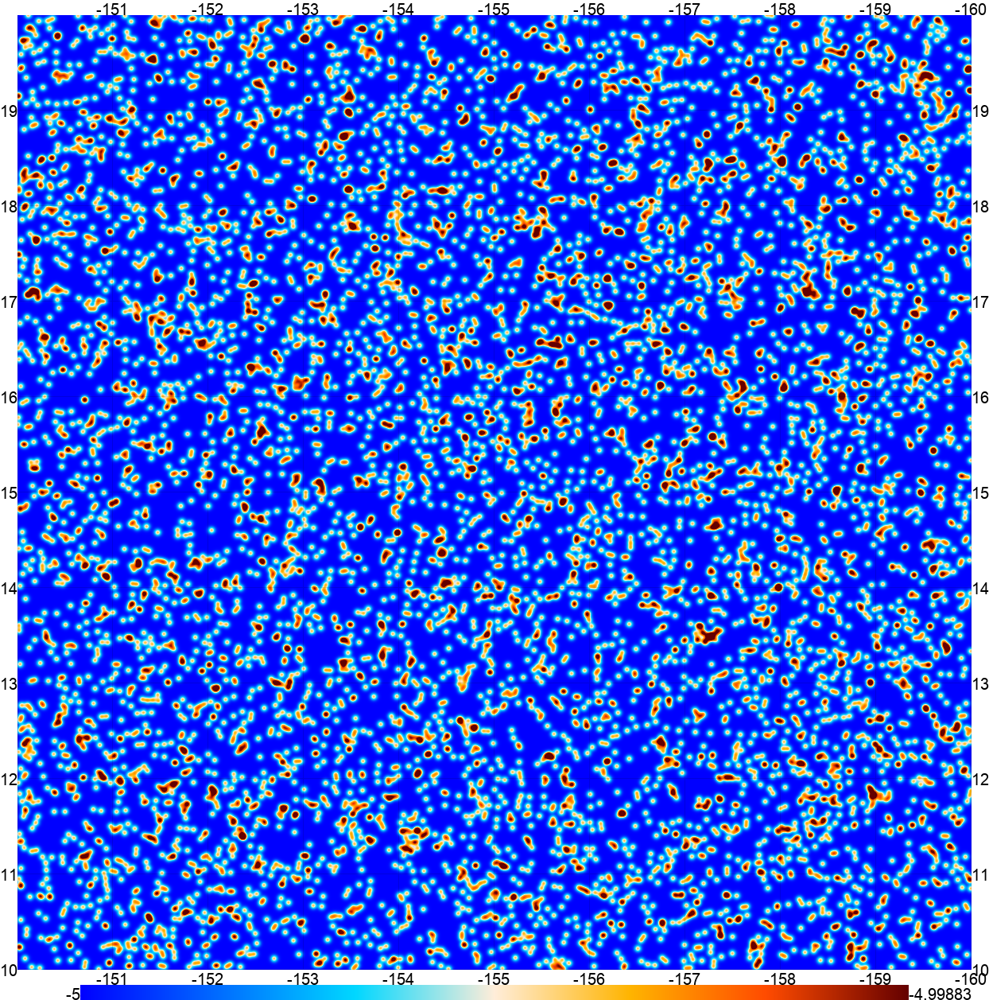

In [34]:
pixell.enplot.pshow(diracEnmap, "-b")
pixell.enplot.pshow(gaussEnmap, "-b")

/home/theo/Documents/research/CMB/tau_sims/../ThumbStack/flat_map.py:456: RuntimeWarning: invalid value encountered in divide
  sCl /= np.sqrt(Nmodes)


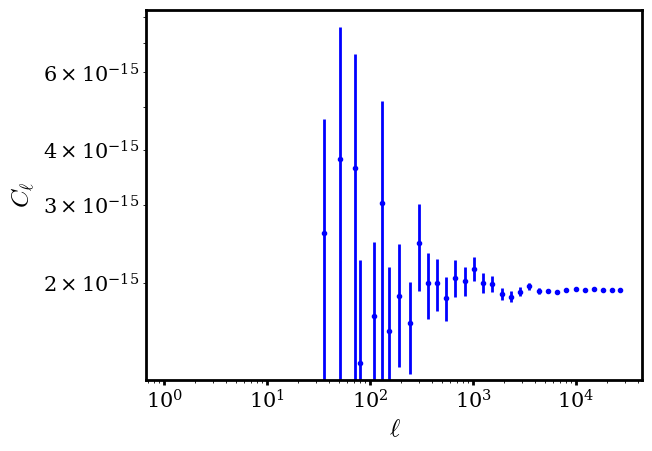

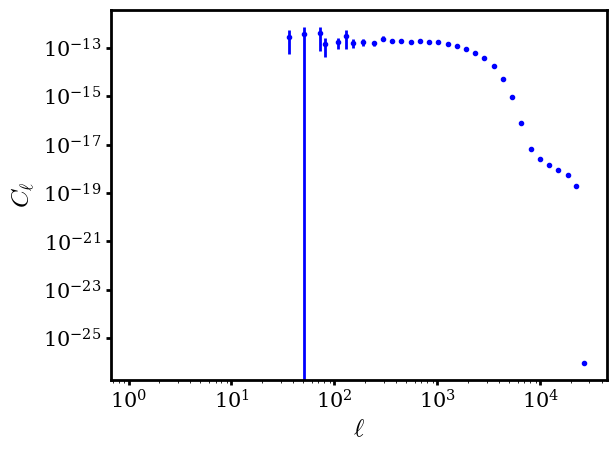

(array([1.11470873e+00, 1.37044237e+00, 1.68484577e+00, 2.07137880e+00,
        2.54658925e+00, 3.13082128e+00, 3.84908633e+00, 4.73213392e+00,
        5.81776804e+00, 7.15246558e+00, 8.79336603e+00, 1.08107177e+01,
        1.32908850e+01, 1.63400461e+01, 2.00887378e+01, 2.46974450e+01,
        3.03634699e+01, 3.60000000e+01, 4.58933913e+01, 5.09116882e+01,
        7.20000000e+01, 8.04984472e+01, 1.09223860e+02, 1.29799846e+02,
        1.51937301e+02, 1.91270149e+02, 2.41465841e+02, 2.98367968e+02,
        3.62562851e+02, 4.48083110e+02, 5.51018255e+02, 6.74563738e+02,
        8.30185858e+02, 1.02254115e+03, 1.25662127e+03, 1.54353860e+03,
        1.89580859e+03, 2.33023163e+03, 2.86609699e+03, 3.52478806e+03,
        4.33291862e+03, 5.32556018e+03, 6.54641300e+03, 8.04916276e+03,
        9.89677158e+03, 1.21670163e+04, 1.49576873e+04, 1.83891357e+04,
        2.21404303e+04, 2.66978844e+04]),
 array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00

In [35]:
# flat_map doesn't automatically calculate the fourier transform of the data
offsetDiracMap.dataFourier = offsetDiracMap.fourier(offsetDiracMap.data)
offsetGaussMap.dataFourier = offsetGaussMap.fourier(offsetGaussMap.data)
offsetDiracMap.powerSpectrum(plot=True)
offsetGaussMap.powerSpectrum(plot=True)

In [36]:
hi_odm, hi_ogm = make_filtered_map([offsetDiracMap, offsetGaussMap], filt=high_pass)
lo_odm, lo_ogm = make_filtered_map([offsetDiracMap, offsetGaussMap], filt=low_pass)

In [37]:
hi_map_list = [hi_odm, hi_ogm]
lo_map_list = [lo_odm, lo_ogm]

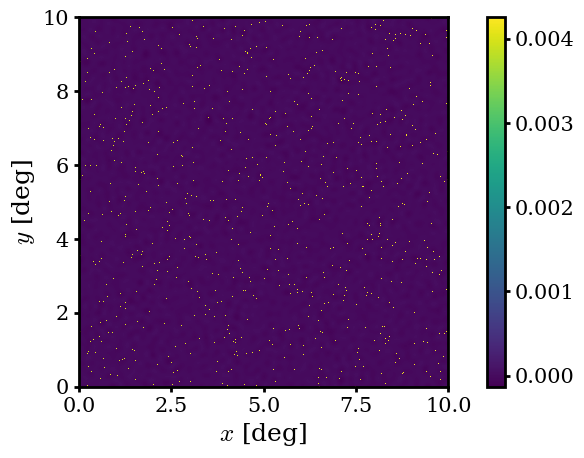

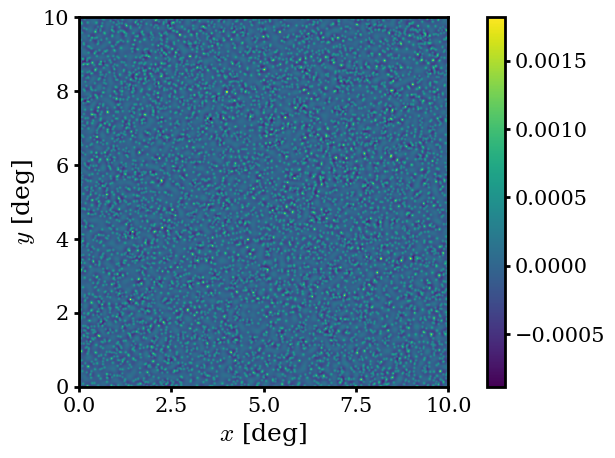

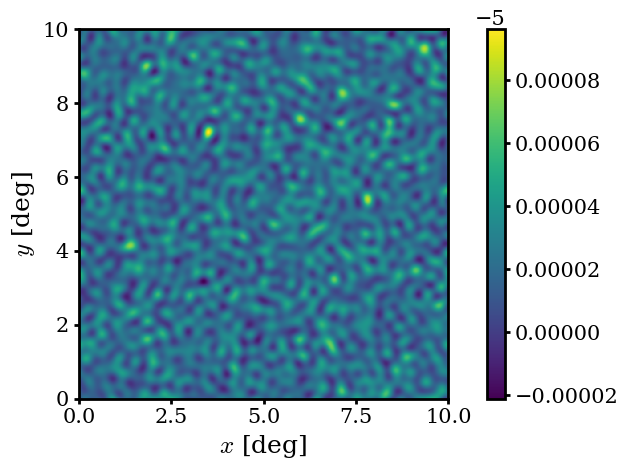

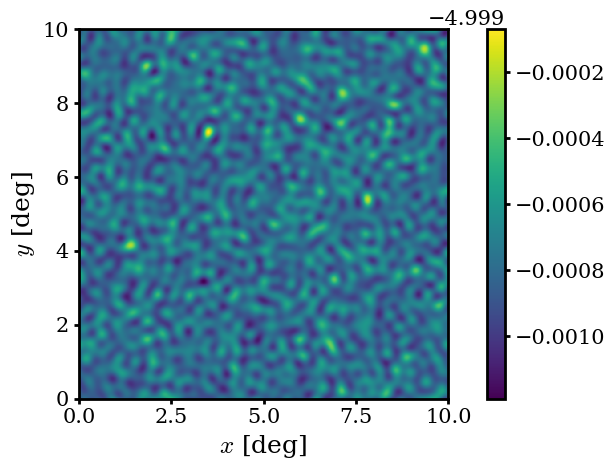

In [38]:
for fm in [hi_odm, hi_ogm]:
    fm.plot()
for fm in [lo_odm, lo_ogm]:
    fm.plot()

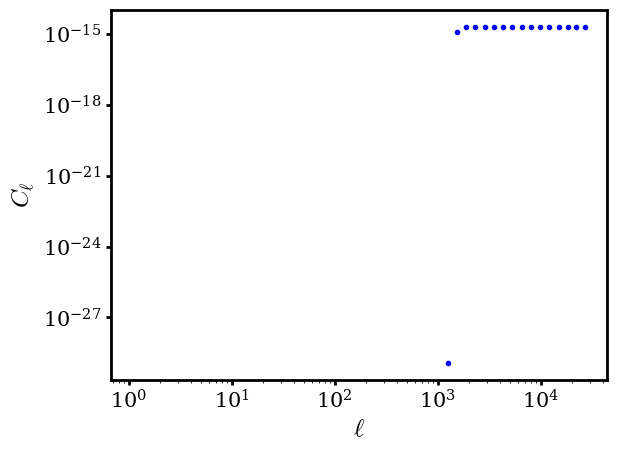

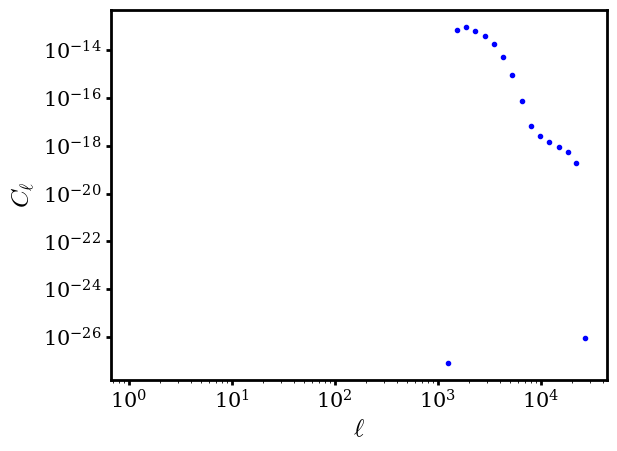

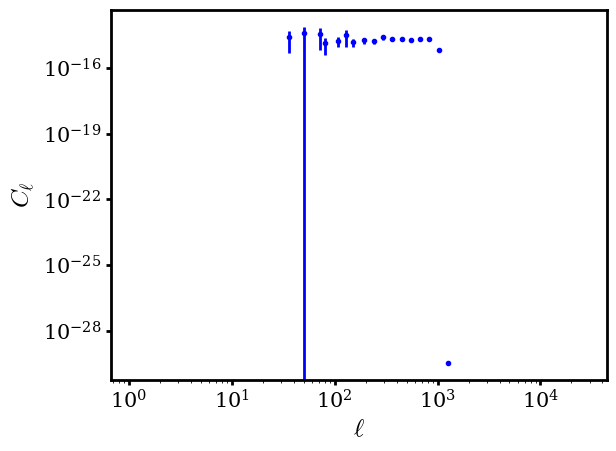

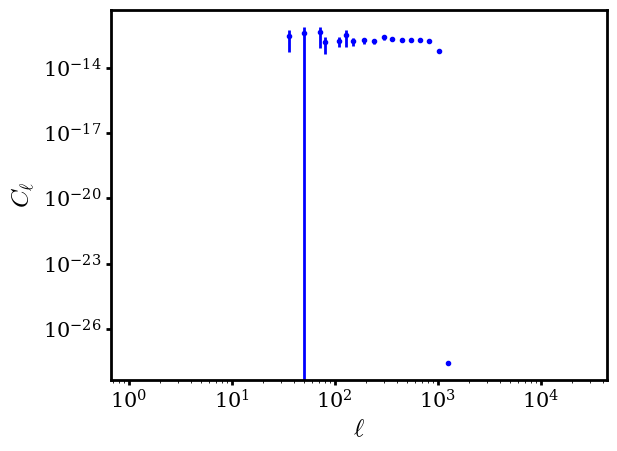

In [39]:
for fm in [hi_odm, hi_ogm]:
    fm.powerSpectrum(plot=True)
for fm in [lo_odm, lo_ogm]:
    fm.powerSpectrum(plot=True)

- load full catalog from ./output/catalog/cmass_m_10x10_randradec_v2/catalog.txt
- Thumbstack: cmass_m_10x10_randradec_v2_dirac_hilo_ring_tsz_bs_v1
Create overlap flag
- 0
took 0.0985326329867045 min
Out of 7676 objects, 7666.0 overlap, ie a fraction 0.9986972381448671
Evaluate all filters on all objects
- analyze object 0
took 3.2388284762700397 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after fu

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
s

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS m

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.01.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cu

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS m

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

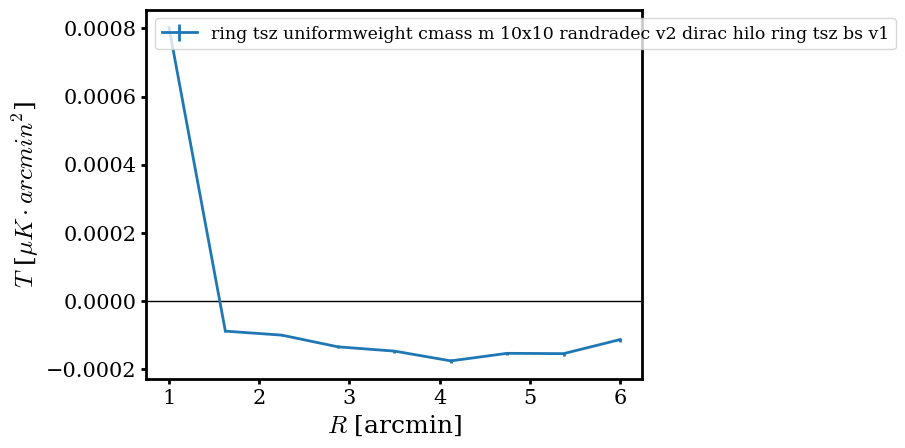

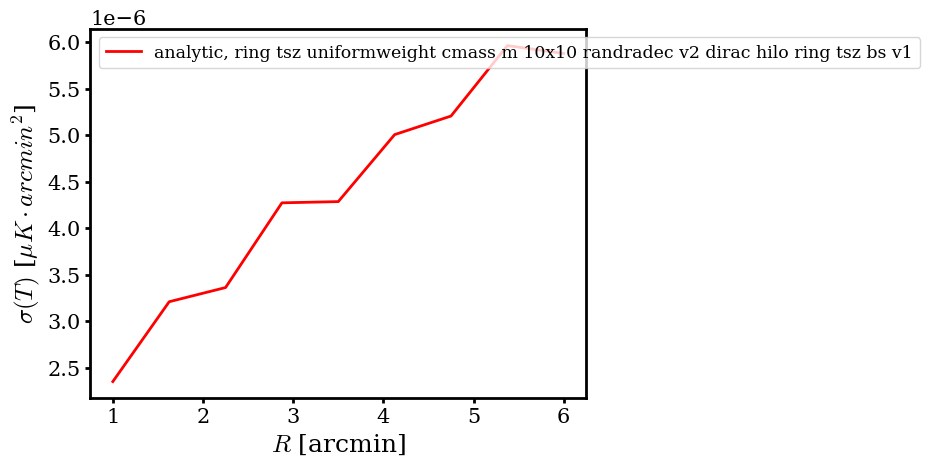

- plot all covariances
- compute all SNR and significances
- compute SNR and significances for ring tsz_uniformweight 
- compute SNR and significances for ring tsz_uniformweight tsz
- compute SNR and significances for ring tsz_uniformweight ksz
- Thumbstack: cmass_m_10x10_randradec_v2_gauss_hilo_ring_tsz_bs_v1
Create overlap flag
- 0
took 0.15897916952768962 min
Out of 7676 objects, 7666.0 overlap, ie a fraction 0.9986972381448671
Evaluate all filters on all objects
- analyze object 0
took 3.3848281939824423 min
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
Measure var for each aperture (no hit count)
- compute all stacked profiles and their cov
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction1.0  of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS m

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.955966

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in th

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS m

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, start with fraction
 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.955966649296

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.95596664929

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fractio

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS m

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fract

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS m

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction  of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweigh

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of obj

keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.99869723814

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.95

- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keep

keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.955966649296

keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of

keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring

keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 of objects after further z cut
keeping fraction 0.9986972381448671 of objects after further overlap cut
keeping fraction 0.9559666492965087 of objects after PS mask
keeping fraction 0.9559666492965087 in the end
- Compute stacked profile: ring, tsz_uniformweight, 
start with fraction 1.0 of objects
keeping fraction 1.0 of objects after mass cut
keeping fraction 1.0 

<Figure size 640x480 with 0 Axes>

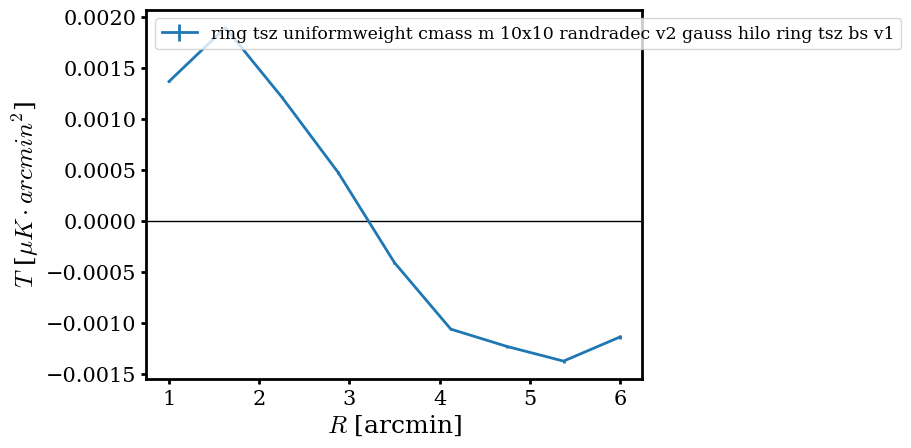

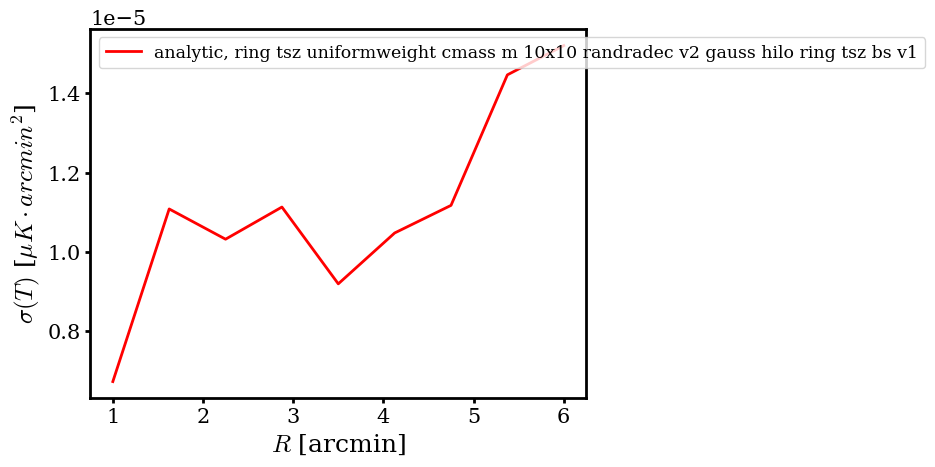

- plot all covariances
- compute all SNR and significances
- compute SNR and significances for ring tsz_uniformweight 
- compute SNR and significances for ring tsz_uniformweight tsz
- compute SNR and significances for ring tsz_uniformweight ksz


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [43]:
# run on full cat with b/s
name = 'cmass_m_10x10_randradec_v2'
cmass_10x10_rand = Catalog(u, massConversion, name=name)

save=True
bootstrap=True
test=False
stackMap=False
names = ['dirac', 'gauss']
for idx in range(2):
    name = cmass_10x10_rand.name + '_%s_hilo_ring_tsz_bs_v1'%names[idx]
    hi_enmap = enmap.enmap(hi_map_list[idx].data, wcs)
    lo_enmap = enmap.enmap(lo_map_list[idx].data, wcs)
    ts_cmass_10x10_rand = ThumbStack(u, cmass_10x10_rand, hi_enmap, boxMask, cmbMap2=lo_enmap, 
        cmbHit=None, name=name, nameLong=None, save=save, nProc=nProc, filterTypes=['ring'],
        doStackedMap=stackMap, doMBins=False, test=test, doBootstrap=bootstrap)